# Visualizing Geospatial Data in Python

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from jupyterthemes import jtplot
import warnings

jtplot.style(theme='chesterish')
warnings.filterwarnings('ignore')
%config InlineBackend.figure_format='retina'

## Chapter 1. Building 2-layer maps : combining polygons and scatterplots

## 1. Introduction

### Location

* 1854 cholera outbreak in London
* 600+ deaths

### Snow's dot map

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/Snows_dot_map.png' alt="Snow's dot map" width=400 align='left'>

### Longitude and latitude

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/Longitude_and_latitude.png' alt='Longitude and latitude' width=600 align='left'>

### Scatterplot styling

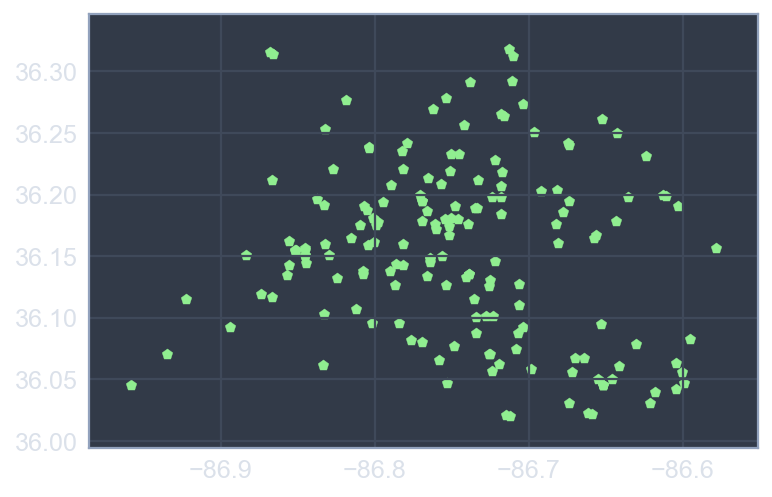

In [2]:
schools = pd.read_csv('Visualizing_Geospatial_Data_in_Python/schools.csv')

plt.scatter(schools.Longitude, schools.Latitude, c = 'lightgreen', marker = 'p')
plt.show()

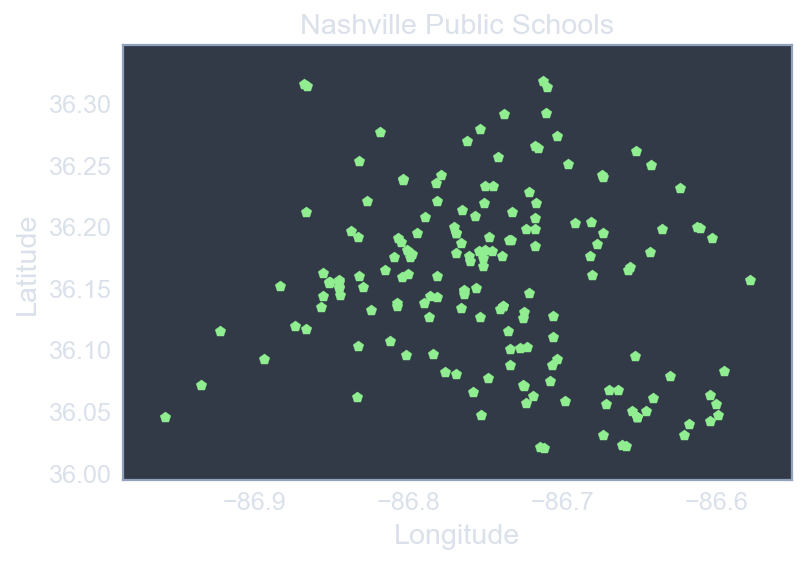

In [3]:
plt.scatter(schools.Longitude,schools.Latitude, c = 'lightgreen', marker = 'p')

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Nashville Public Schools')

plt.grid()
plt.show()

### Extracting longitude and latitude

In [4]:
bus_stops = pd.read_csv('Visualizing_Geospatial_Data_in_Python/bus_stops.csv')
bus_stops.head()

,StopID,StopName,Location
0,4431,MUSIC CITY CENTRAL 5TH - BAY 11,"(36.16659, -86.781996)"
1,588,CHARLOTTE AVE & 7TH AVE N WB,"(36.165, -86.78406)"
2,590,CHARLOTTE AVE & 8TH AVE N WB,"(36.164393, -86.785451)"
3,541,11TH AVE / N GULCH STATION OUTBOUND,"(36.162249, -86.790464)"


In [5]:
bus_stops['lat'] = [loc[0] for loc in bus_stops.Location]
bus_stops['lng'] = [loc[1] for loc in bus_stops.Location]
bus_stops.head()

,StopID,StopName,Location,lat,lng
0,4431,MUSIC CITY CENTRAL 5TH - BAY 11,"(36.16659, -86.781996)",(,3
1,588,CHARLOTTE AVE & 7TH AVE N WB,"(36.165, -86.78406)",(,3
2,590,CHARLOTTE AVE & 8TH AVE N WB,"(36.164393, -86.785451)",(,3
3,541,11TH AVE / N GULCH STATION OUTBOUND,"(36.162249, -86.790464)",(,3


### Extracting longitude and latitude with regular expressions

In [6]:
bus_stops2 = pd.read_csv('Visualizing_Geospatial_Data_in_Python/bus_stops2.csv')
bus_stops2.head()

,Stop ID,Location
0,4431,"MCC - BAY 11\nNashville, TN\n(36.16659, -86.78..."
1,588,"CHARLOTTE AVE\nNashville, TN\n(36.165, -86.78406)"
2,590,"CHARLOTTE AV\nNashville, TN\n(36.164393, -86.7..."
3,541,"CHARLOTTE\nNashville, TN\n(36.162249, -86.790464)"
4,5231,"Nashville, TN\n(36.163822, -86.783791)"


In [7]:
import re

lat_lng_pattern = re.compile(r'\((.*),\s*(.*)\)', flags=re.MULTILINE)
def extract_lat_lng(address):
    try:
        lat_lng_match = lat_lng_pattern.search(address)
        lat = float(lat_lng_match.group(1))
        lng = float(lat_lng_match.group(2))
        return (lat, lng)
    except:
        return (np.NaN, np.NaN)

In [8]:
lat_lngs = [extract_lat_lng(location) for location \
            in bus_stops2.loc[:,'Location']]
bus_stops2['lat'] = [lat for lat, lng in lat_lngs]
bus_stops2['lng'] = [lng for lat, lng in lat_lngs]

bus_stops2.head()

,Stop ID,Location,lat,lng
0,4431,"MCC - BAY 11\nNashville, TN\n(36.16659, -86.78...",36.166590,-86.781990
1,588,"CHARLOTTE AVE\nNashville, TN\n(36.165, -86.78406)",36.165000,-86.784060
2,590,"CHARLOTTE AV\nNashville, TN\n(36.164393, -86.7...",36.164393,-86.785451
3,541,"CHARLOTTE\nNashville, TN\n(36.162249, -86.790464)",36.162249,-86.790464
4,5231,"Nashville, TN\n(36.163822, -86.783791)",36.163822,-86.783791


### №1 Plotting a scatterplot from longitude and latitude

When using latitude and longitude to create a scatterplot, which value is plotted along the horizontal axis (as x)?

* Latitude is plotted as x on the horizontal axis
* *Longitude is plotted as x on the horizontal axis*
* Latitude in the Northern hemisphere, longitude in the Southern hemisphere
* It doesn't really matter

### №2 Styling a scatterplot

1. 
    * Import the `pyplot` module from `matplotlib` with the usual alias
    * Create a scatterplot of father and son heights with a square marker (encoded as `s`) that is `'darkred'`. Show your plot

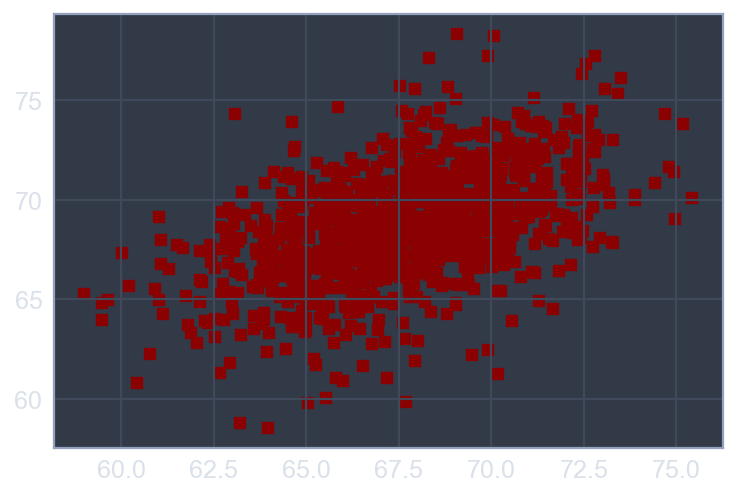

In [9]:
father_son = pd.read_csv('Visualizing_Geospatial_Data_in_Python/father_son.csv')

plt.scatter(father_son.fheight, father_son.sheight, c = 'darkred', marker = 's')
plt.show()

2. Edit the code to change the markers for your scatterplot of father heights vs son heights. Make the markers `'yellow'` with a `'darkblue'` edgecolor

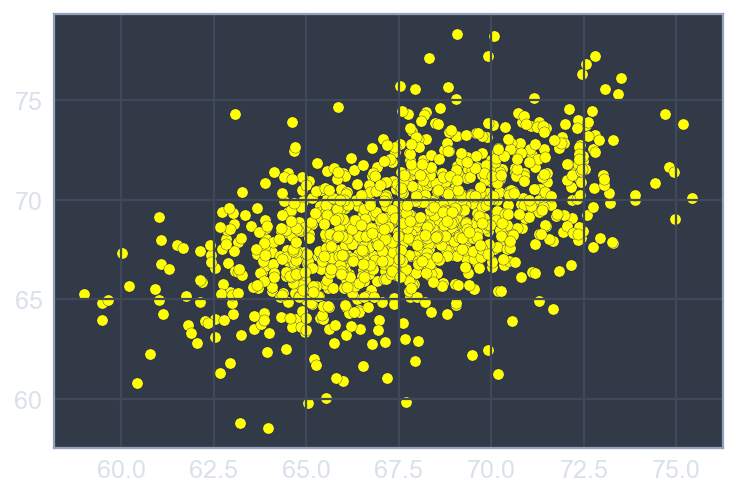

In [10]:
plt.scatter(father_son.fheight, father_son.sheight, edgecolor = 'darkblue', c = 'yellow')
plt.show()

3. 
    * Add gridlines and axes labels (`'father height (inches)'` and `'son height (inches)'`) to your scatterplot
    * Give the plot a title of `'Son Height as a Function of Father Height'`

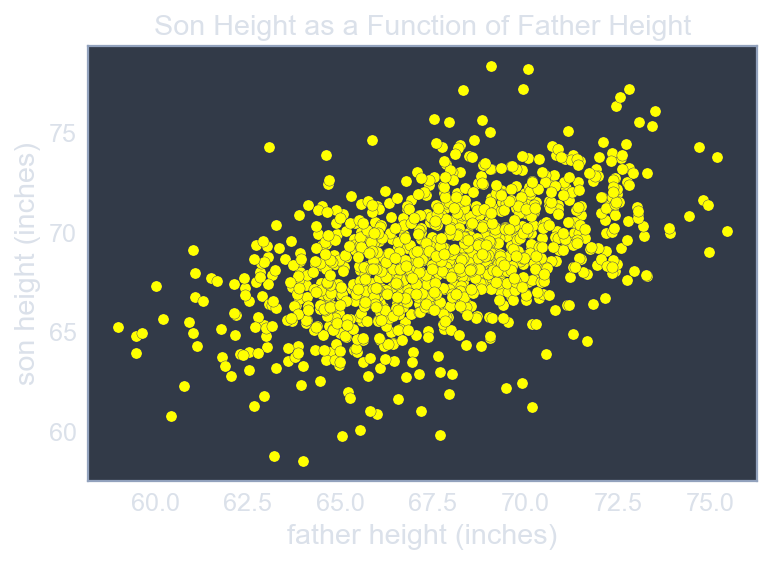

In [11]:
plt.scatter(father_son.fheight, father_son.sheight,  c = 'yellow', edgecolor = 'darkblue')

plt.grid()
plt.xlabel('father height (inches)')
plt.ylabel('son height (inches)')
plt.title('Son Height as a Function of Father Height')

plt.show()

### №3 Extracting longitude and latitude

* Print the first few rows with `print()` and `df.head()`
* Use a list comprehension to extract latitude to a new column called `lat`
* Use a list comprehension to extract longitude to a new column called `lng`
* Print the first few rows with `print()` and `df.head()` again to confirm the new columns

In [12]:
df = pd.read_csv('Visualizing_Geospatial_Data_in_Python/busstop.csv')
print(df.head())

df['lat'] = [loc[0] for loc in df.Location]
df['lng'] = [loc[1] for loc in df.Location]

print(df.head())

   StopID                             StopName                 Location  \
0    4431      MUSIC CITY CENTRAL 5TH - BAY 11   (36.16659, -86.781996)   
1     588         CHARLOTTE AVE & 7TH AVE N WB      (36.165, -86.78406)   
2     590         CHARLOTTE AVE & 8TH AVE N WB  (36.164393, -86.785451)   
3     541  11TH AVE / N GULCH STATION OUTBOUND  (36.162249, -86.790464)   

         lat        lng  
0  36.166590 -86.781996  
1  36.165000 -86.784060  
2  36.164393 -86.785451  
3  36.162249 -86.790464  
   StopID                             StopName                 Location lat  \
0    4431      MUSIC CITY CENTRAL 5TH - BAY 11   (36.16659, -86.781996)   (   
1     588         CHARLOTTE AVE & 7TH AVE N WB      (36.165, -86.78406)   (   
2     590         CHARLOTTE AVE & 8TH AVE N WB  (36.164393, -86.785451)   (   
3     541  11TH AVE / N GULCH STATION OUTBOUND  (36.162249, -86.790464)   (   

  lng  
0   3  
1   3  
2   3  
3   3  


### №4 Plotting chicken locations

* The path to the chicken dataset is in the variable `chickens_path`. Use the `read_csv `function of pandas to load it into a DataFrame called `chickens`
* Use the `.head()` function to look at the first few rows
* Next add the x and y arguments to `plt.scatter()` to plot the locations of the Nashville chickens. Use the default marker and color options
* Show the plot using `plt.show()`

   permit       city state    zip  district date_issued        lat        lng
0   288.0  Nashville    TN  37211      30.0  11/26/2014  36.029132 -86.724578
1   435.0  Nashville    TN  37211      19.0  05/18/2015  36.069132 -86.754578
2   270.0  Nashville    TN  37216       7.0  11/20/2014  36.236134 -86.711204
3   249.0  Nashville    TN  37216      25.0  12/29/2014  36.246134 -86.751204
4   200.0  Nashville    TN  37221      22.0  12/10/2014  36.029367 -86.935290


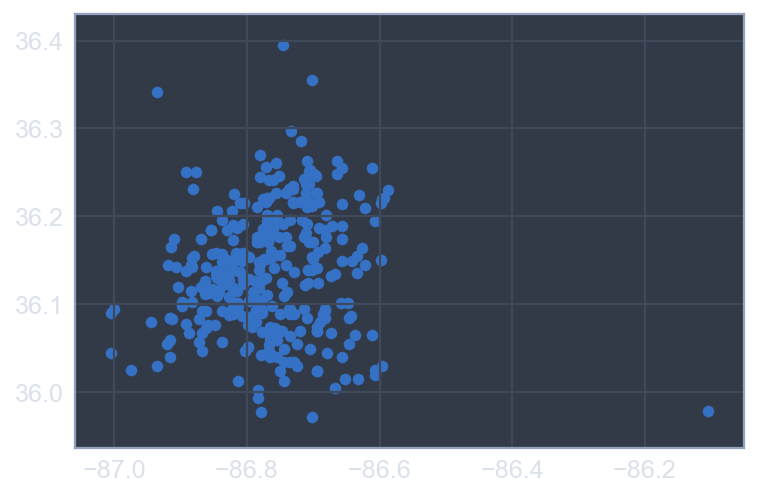

In [13]:
chickens_path = 'Visualizing_Geospatial_Data_in_Python/chickens.csv'

chickens = pd.read_csv(chickens_path)
print(chickens.head())

plt.scatter(x = chickens.lng, y = chickens.lat)
plt.show()

## 2. Geometries and shapefiles

### Shapefiles

* Shapefiles store a special type of data known as geometry

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/Shapefiles.png' alt='Shapefiles' align='left' width=300>

### Shapefile components

**KEEP ALL THE FILES TOGETHER!**

```shell
$ ls my_map_files/

my_map.dbf
my_map.shp
my_map.shx
```

* my_map.shp (contains the geometry)
* my_map.dbf (holds attributes for each geometry)
* my_map.shx (links the attributes to the geometry)

### geopandas

This code reads a shapefile into a GeoDataFrame and looks at the first few rows

```python
import geopandas as gpd

geo_df = gpd.read_file('My_Map_Files/my_map.shp')
geo_df.head()
```

### Viewing a geometry

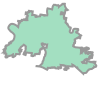

In [14]:
import geopandas as gpd

service_district = gpd.read_file('Visualizing_Geospatial_Data_in_Python/' \
                                 'service_district.geojson.txt')
service_district.loc[0, 'geometry']

### Printing a geometry

In [15]:
print(service_district.loc[0, 'geometry'])

POLYGON ((-86.68680500011935 36.28670500013504, -86.68706099969657 36.28550299967364, -86.68709498823965 36.28511683351293, -86.68712691935902 36.28475404474551, -86.6871549990252 36.28443499969863, -86.68715025108719 36.28438104319917, -86.68708600011215 36.2836510002216, -86.6870599998375 36.28335400009232, -86.68683200030846 36.28073200026927, -86.68678671280243 36.2804916722591, -86.68668199966068 36.27993600019391, -86.686543000303 36.27920000021985, -86.68641799989246 36.27853199938513, -86.68600744248923 36.27759483150202, -86.68579942352289 36.27711998225582, -86.68482299948184 36.2748910007355, -86.68476799897849 36.27478700083996, -86.68372700043393 36.27281799971492, -86.6832880000829 36.27208000018629, -86.68313199902317 36.27181700012145, -86.68278700024624 36.27108100075766, -86.68257822861736 36.27077209799597, -86.68177585777893 36.2694062861527, -86.68129400001521 36.2685690000872, -86.68085800015712 36.26798600010722, -86.68029000024265 36.26730000044872, -86.67943799

### Plotting a GeoDataFrame

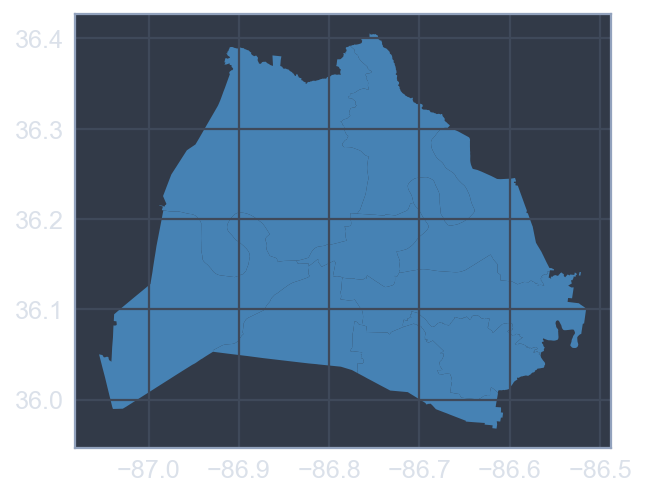

In [16]:
school_districts = gpd.read_file('Visualizing_Geospatial_Data_in_Python/' \
                                 'school_districts.geojson')

school_districts.plot(color='steelblue')
plt.show()

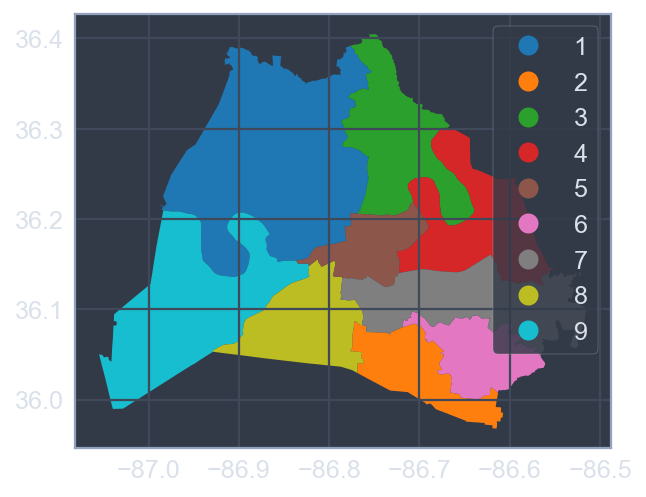

In [17]:
school_districts.plot(column ='district', legend = True)
plt.show()

### №5 Creating a GeoDataFrame & examining the geometry

* Import `geopandas` with its common alias `gpd`
* Read in the service district shapefile using `geopandas` and look at the first 5 rows using the `head()` method
* Print the geometry field in the first row (rowname is '0') to see the data contained in that field. You will pass `service_district.loc[0, 'geometry']` to the `print()` function to do this

In [18]:
import geopandas as gpd 

service_district = gpd.read_file('Visualizing_Geospatial_Data_in_Python/' \
                                 'service_district.geojson.txt')
print(service_district.head())
print(service_district.loc[0, 'geometry'])

  id  area_sq_mi  objectid                       name  \
0  0       198.0       0.0    Urban Services District   
1  1       327.0       4.0  General Services District   

                                            geometry  
0  POLYGON ((-86.68680500011935 36.28670500013504...  
1  (POLYGON ((-86.56776164301485 36.0342383159728...  
POLYGON ((-86.68680500011935 36.28670500013504, -86.68706099969657 36.28550299967364, -86.68709498823965 36.28511683351293, -86.68712691935902 36.28475404474551, -86.6871549990252 36.28443499969863, -86.68715025108719 36.28438104319917, -86.68708600011215 36.2836510002216, -86.6870599998375 36.28335400009232, -86.68683200030846 36.28073200026927, -86.68678671280243 36.2804916722591, -86.68668199966068 36.27993600019391, -86.686543000303 36.27920000021985, -86.68641799989246 36.27853199938513, -86.68600744248923 36.27759483150202, -86.68579942352289 36.27711998225582, -86.68482299948184 36.2748910007355, -86.68476799897849 36.27478700083996, -86.6837270004

### №6 Plotting shapefile polygons

* First plot the service districts without additonal arguments by calling `.plot()` on the GeoDataFrame
* Take a look at it with `plt.show()`
* Now use the `.plot()` method again, but this time add `column='name'` to color the shapes according to their names and legend=True to see those names. Remember to show the plot

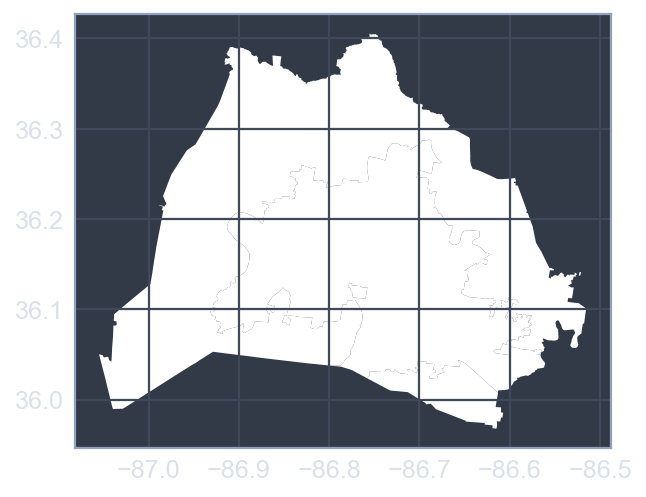

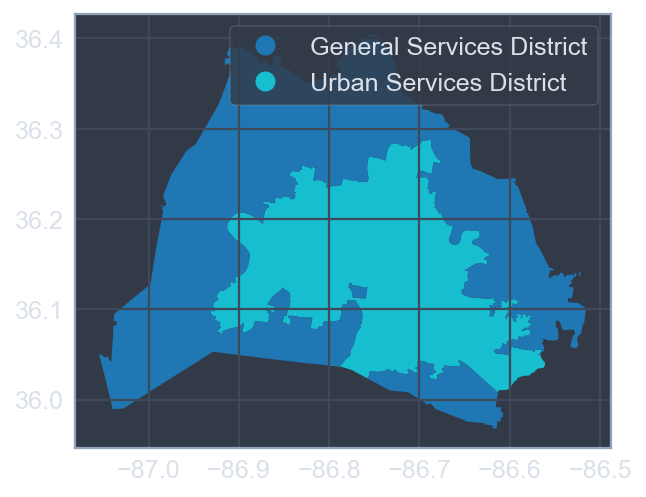

In [19]:
service_district.plot(color='white')
plt.show()

service_district.plot(column = 'name', legend = True)
plt.show()

## 3. Putting it all together

### Skills list

* Understanding longitude and latitude
* Extracting longitude and latitude
* Plotting points on scatterplot using longitude and latitude
* Styling scatterplots for better aesthetics and insight
* Plotting polygons from shapefiles

### Combining scatterplots and polygons

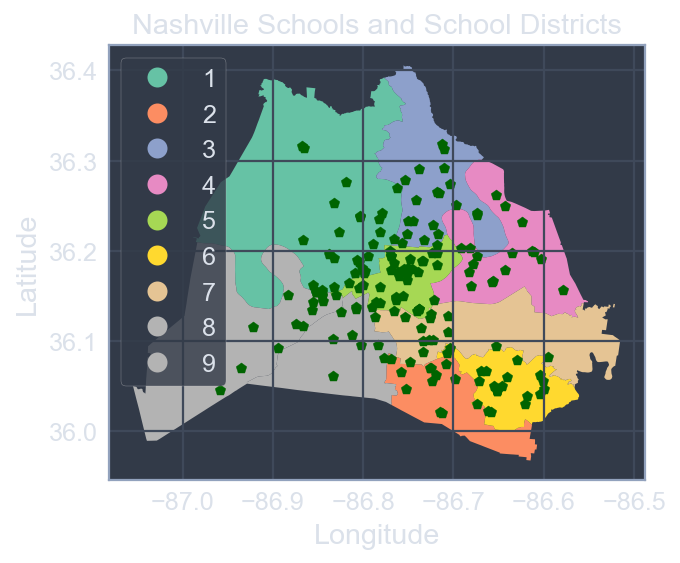

In [20]:
school_districts = gpd.read_file('Visualizing_Geospatial_Data_in_Python/' \
                                 'school_districts.geojson')

school_districts.plot(column = 'district', legend = True, cmap = 'Set2')
plt.scatter(schools.Longitude, schools.Latitude, marker = 'p', c = 'darkgreen')

plt.title('Nashville Schools and School Districts')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

### №7 Geometry

Geometry is a special type of data structure. What types of geometries might be stored in a geometry field?

* polygons, rectangles, points
* lines, points, and intersecting lines
* *lines, points, and polygons*
* squares, triangles, and polygons

### №8 Plotting points over polygons - part 1

* Plot the shapefile for the service districts, using the `name` column to color the polygons
* Add chicken locations, using the `lat` and `lng` columns from the chickens DataFrame, and make them black
* Show your plot

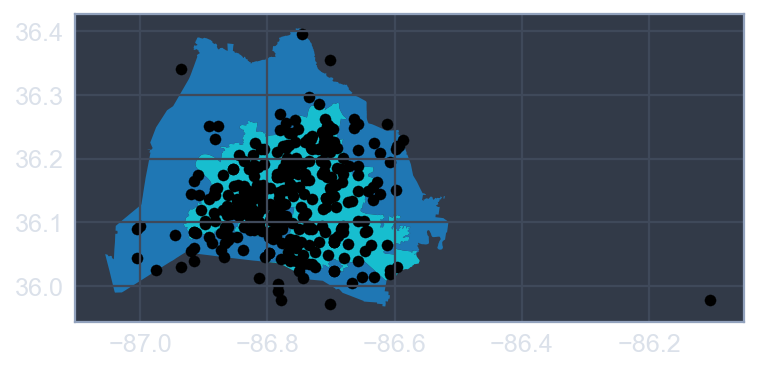

In [21]:
service_district.plot(column='name')
plt.scatter(x=chickens.lng, y=chickens.lat, c = 'black')
plt.show()

### №9 Plotting points over polygons - part 2

* Start by plotting the `GeoDataFrame` with the service districts. Use the name column for your legend color
* Next plot latitude and longitude from the chicken data to create a scatterplot. Specify `'black'` for the marker color and give them a `'white'` outline
* Give the plot a title: `'Nashville Chicken Permits'` and label the x-axis as `'longitude'` and the y-axis as `'latitude'`
* Add grid lines and show your plot

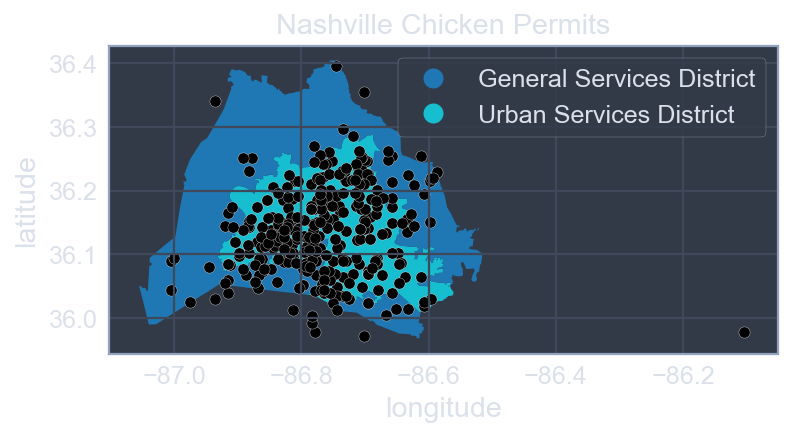

In [22]:
service_district.plot(column='name', legend=True)
plt.scatter(x=chickens.lng, y=chickens.lat, c = 'black', edgecolor = 'white')

plt.title('Nashville Chicken Permits')
plt.xlabel('longitude')
plt.ylabel('latitude')

plt.show()

## Chapter 2. Creating and joining GeoDataFrames

## 4. Plotting with GeoJSON

### Neighborhoods GeoJSON

```
{
  'type': 'FeatureCollection',
  'features': [
    {
      'type':'Feature',
      'properties':
        {
          'name':'Historic Buena Vista'
        },
      'geometry':
        {
          'type':'MultiPolygon',
          'coordinates':[[[[-86.79511056795417,36.17575964963348],
          [-86.79403325521203,36.176723819622765],
          [-86.79395847673587,36.176734201205555],
          [-86.79373059621346,36.17641850227536],
          ...
```

In [23]:
neighborhoods = gpd.read_file('Visualizing_Geospatial_Data_in_Python/neighborhoods.geojson')
neighborhoods.head(1)

,name,geometry
0,Historic Buena Vista,(POLYGON ((-86.79511056795417 36.1757596496334...


### Geopandas dependencies

* Fiona
    * provides an python API for OGR
* GDAL/OGR
    * GDAL for translating raster data
    * OGR for translating vector data
    
<img src='Visualizing_Geospatial_Data_in_Python/Pictures/Geopandas_dependencies.png' alt='Geopandas dependencies' width=300 align='left'>

### Comparing raster and vector graphics

* raster image of Corfu

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/raster_image_of_Corfu.png' alt='raster image of Corfu' width=300 align='left'>

* vector image of Corfu

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/vector_image_of_Corfu.png' alt='vector image of Corfu' width=300 align='left'>

### Colormaps

* [Colormaps](https://matplotlib.org/users/colormaps.html)

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/grayscale_01_04.png' alt='Quantitative Colormaps' width=400 align='left'>

### Plotting with color

In [24]:
school_districts.head(3)

,first_name,city,zip,email,state,last_name,address,position,term_expir,district,phone,geometry
0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,(POLYGON ((-86.77136400034288 36.3835669997190...
1,Jill,Madison,37115,jill.speering@mnps.org,TN,Speering,1033 Falls Avenue,Vice-Chair,2016,3,615-562-5234,(POLYGON ((-86.75364713283636 36.4042760799855...
2,Dr. Jo Ann,Nashville,37220,joann.brannon@mnps.org,TN,Brannon,5444 San Marcos Drive,Member,2018,2,615-833-5976,(POLYGON ((-86.76696199971282 36.0833250002130...


### The legend_kwds argument to .plot()

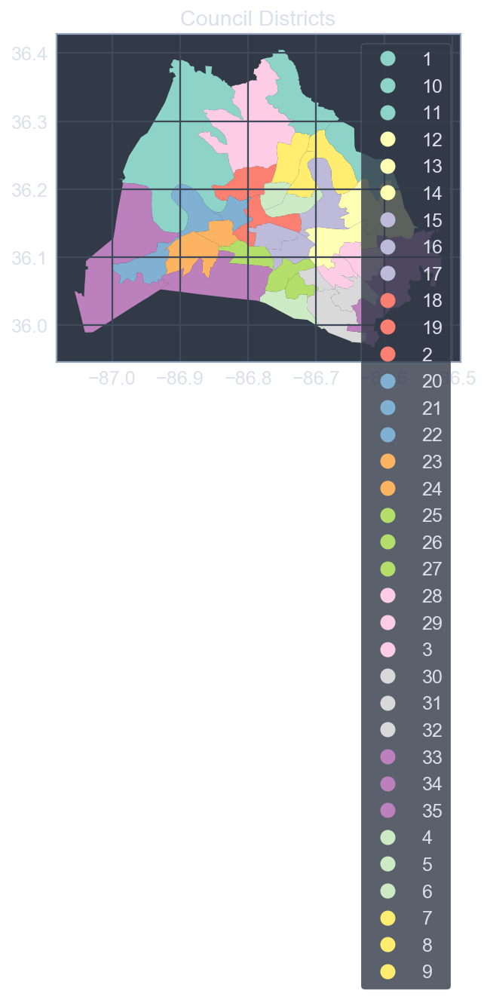

In [25]:
council_districts = gpd.read_file('Visualizing_Geospatial_Data_in_Python/council_districts.geojson')

council_districts.plot(column='district', cmap='Set3', legend=True)
plt.title('Council Districts')
plt.show()

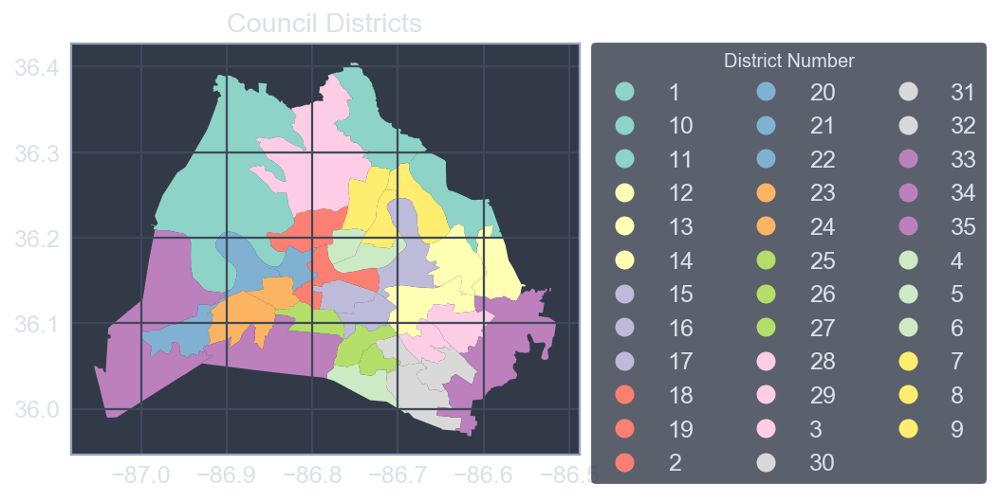

In [26]:
leg_kwds={'title':'District Number', 'loc': 'upper left', 'bbox_to_anchor':(1, 1.03), 'ncol':3}

council_districts.plot(column='district', cmap='Set3', legend=True, legend_kwds=leg_kwds)
plt.title('Council Districts')
plt.show();

### №10 Working with GeoJSON

Еhe advantage of GeoJSON over shapefiles is:

* The file is human readable, so you can open it in a text editor and understand the contents
* The file stands alone and doesn't rely on other files
* GeoJSON supports multi-part geometries
* *All of these are advantage*

### №11 Colormaps

1. Plot `school_districts` with the `tab20` colormap. Use `'district'` to create a legend and set `legend_kwds = lgnd_kwds`

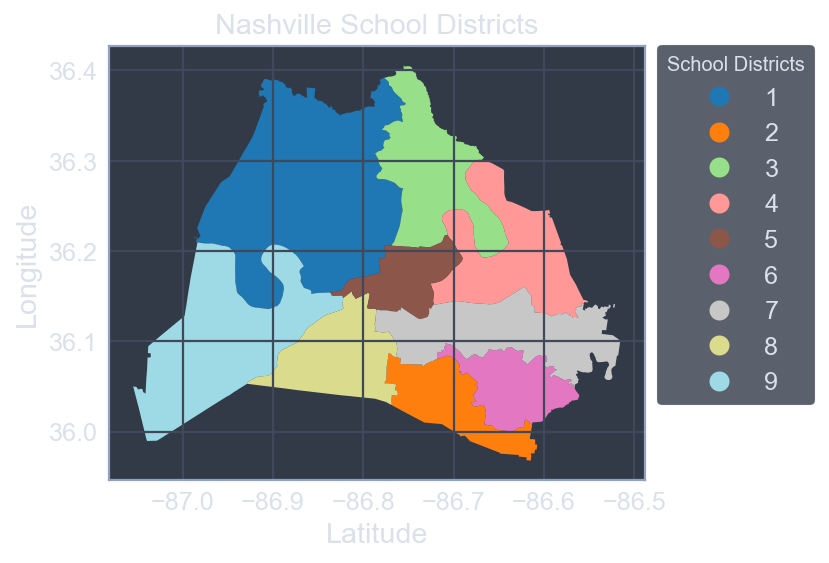

In [27]:
lgnd_kwds = {'title': 'School Districts', 'loc': 'upper left',
             'bbox_to_anchor': (1, 1.03), 'ncol': 1}

school_districts.plot(column = 'district', cmap = 'tab20',
                      legend = True,legend_kwds = lgnd_kwds)
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Nashville School Districts')
plt.show()

2. Plot `school_districts` with the sequential `summer` colormap. Keep the other arguments as they are

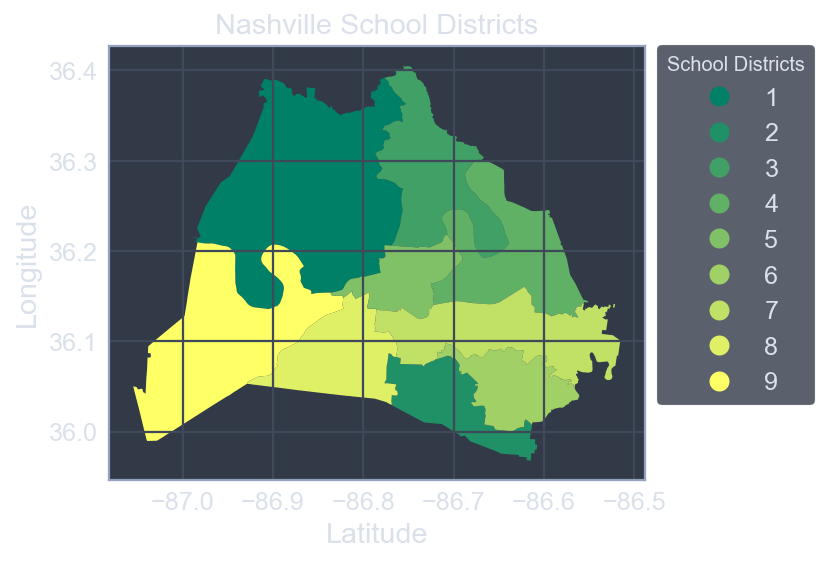

In [28]:
school_districts.plot(column = 'district', cmap = 'summer',
                      legend = True, legend_kwds = lgnd_kwds)
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Nashville School Districts')

plt.show()

3. Plot the school districts without setting the `column`. Use the qualitative `Set3` colormap and set `legend = True`

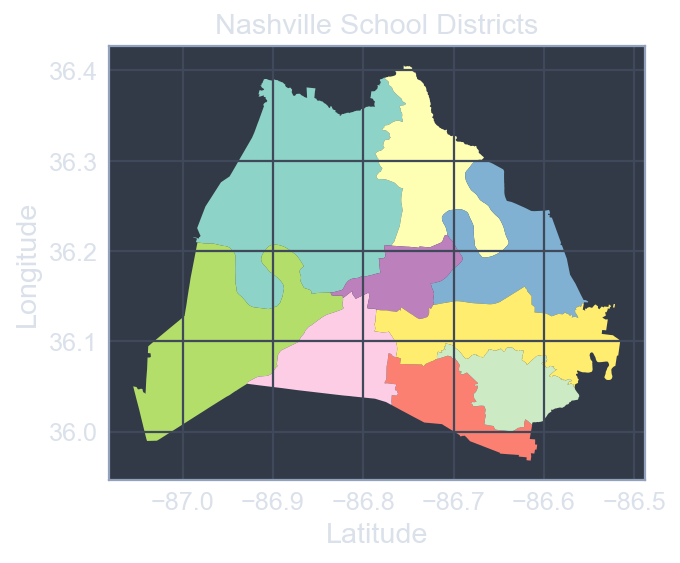

In [29]:
school_districts.plot(cmap = 'Set3', legend = True, legend_kwds = lgnd_kwds)

plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Nashville School Districts')

plt.show()

### №12 Map Nashville neighborhoods

* Import `geopandas` and `matplotlib.pyplot` using the customary aliases
* Read in the neighborhoods GeoJSON file to a GeoDataFrame called `neighborhoods` and print the first few rows with `.head()`. The path to this file is stored in a variable called `neighborhoods_path`
* Plot `neighborhoods` coloring the polygons by the `name` column of the GeoDataFrame and using the `Dark2` color map. This time, don't include a legend
* Show the plot

                   name                                           geometry
0  Historic Buena Vista  (POLYGON ((-86.79511056795417 36.1757596496334...
1        Charlotte Park  (POLYGON ((-86.87459668651866 36.1575770268129...
2              Hillwood  (POLYGON ((-86.87613708067906 36.1355409894979...
3            West Meade  (POLYGON ((-86.9038380396094 36.1255414807897,...
4          White Bridge  (POLYGON ((-86.86321427797685 36.1288622289404...


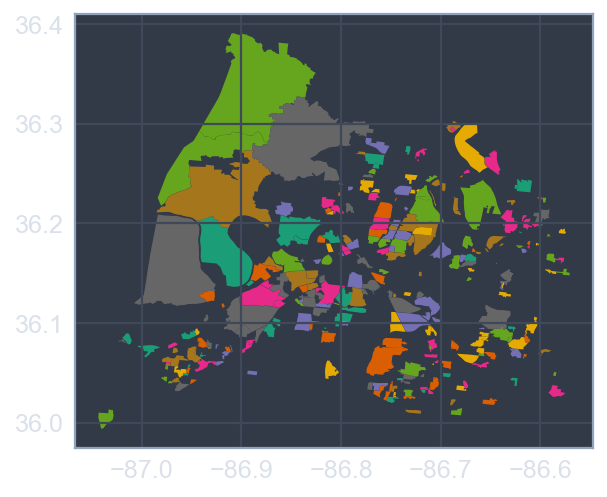

In [30]:
import geopandas as gpd
import matplotlib.pyplot as plt

neighborhoods_path = 'Visualizing_Geospatial_Data_in_Python/neighborhoods.geojson'

neighborhoods = gpd.read_file(neighborhoods_path)
print(neighborhoods.head())

neighborhoods.plot(column = 'name', cmap = 'Dark2')
plt.show()

## 5. Projections and Coordinate Reference Systems

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/Globe.png' alt='Globe' width=800 align='left'>

### Coordinate Reference Systems

**EPSG:4326**
* used by Google Earth
* units are decimal degrees

**EPSG:3857**
* used by Google Maps, Bing Maps, Open Street Maps
* units are meters

### Creating a geometry column

In [31]:
schools_2 = schools[['School Name', 'Latitude', 'Longitude']]
schools_2.head()

,School Name,Latitude,Longitude
0,A. Z. Kelley Elementary,36.021817,-86.658848
1,Alex Green Elementary,36.252961,-86.832229
2,Amqui Elementary,36.273766,-86.703832
3,Andrew Jackson Elementary,36.231585,-86.623775
4,Antioch High School,36.046675,-86.599418


In [32]:
# create a point geometry column
from shapely.geometry import Point

schools_2['geometry'] = schools_2.apply(lambda x: Point((x.Longitude, x.Latitude)), axis = 1)
schools_2.head()

,School Name,Latitude,Longitude,geometry
0,A. Z. Kelley Elementary,36.021817,-86.658848,POINT (-86.65884778 36.02181712)
1,Alex Green Elementary,36.252961,-86.832229,POINT (-86.8322292 36.2529607)
2,Amqui Elementary,36.273766,-86.703832,POINT (-86.70383153 36.27376585)
3,Andrew Jackson Elementary,36.231585,-86.623775,POINT (-86.62377469 36.23158465)
4,Antioch High School,36.046675,-86.599418,POINT (-86.59941833000001 36.04667464)


### Creating a GeoDataFrame from a DataFrame

In [33]:
import geopandas as gpd

schools_crs = {'init': 'epsg:4326'}
schools_geo = gpd.GeoDataFrame(schools_2, crs = schools_crs, geometry = schools_2.geometry)

schools_geo.head(4)

,School Name,Latitude,Longitude,geometry
0,A. Z. Kelley Elementary,36.021817,-86.658848,POINT (-86.65884778 36.02181712)
1,Alex Green Elementary,36.252961,-86.832229,POINT (-86.8322292 36.2529607)
2,Amqui Elementary,36.273766,-86.703832,POINT (-86.70383153 36.27376585)
3,Andrew Jackson Elementary,36.231585,-86.623775,POINT (-86.62377469 36.23158465)


### Changing from one CRS to another

In [34]:
schools_geo.head(2)

,School Name,Latitude,Longitude,geometry
0,A. Z. Kelley Elementary,36.021817,-86.658848,POINT (-86.65884778 36.02181712)
1,Alex Green Elementary,36.252961,-86.832229,POINT (-86.8322292 36.2529607)


In [35]:
# convert geometry from decimal degrees to meters
schools_geo.geometry = schools_geo.geometry.to_crs(epsg = 3857)

schools_geo.head(2)

,School Name,Latitude,Longitude,geometry
0,A. Z. Kelley Elementary,36.021817,-86.658848,POINT (-9646818.807601407 4303623.789516844)
1,Alex Green Elementary,36.252961,-86.832229,POINT (-9666119.538988819 4335484.432376049)


### №13 Changing coordinate reference systems

* Print the first row of `school_districts` and the `crs` property of this GeoDataFrame
* Convert the coordinate reference system of `school_districts` to `epsg:3857`
* Print the `crs` property again to confirm that it was changed

In [36]:
print(school_districts.head(1))
print(school_districts.crs)

school_districts.geometry = school_districts.geometry.to_crs(epsg = 3857)

print(school_districts.head(1))
print(school_districts.crs)

   first_name       city    zip                           email state  \
0  Dr. Sharon  Nashville  37218  gentryfordistrict1@comcast.net    TN   

  last_name          address position term_expir district         phone  \
0    Gentry  6108 Beals Lane   Member       2016        1  615-268-5269   

                                            geometry  
0  (POLYGON ((-86.77136400034288 36.3835669997190...  
{'init': 'epsg:4326'}
   first_name       city    zip                           email state  \
0  Dr. Sharon  Nashville  37218  gentryfordistrict1@comcast.net    TN   

  last_name          address position term_expir district         phone  \
0    Gentry  6108 Beals Lane   Member       2016        1  615-268-5269   

                                            geometry  
0  (POLYGON ((-9659344.055955959 4353528.76657080...  
{'init': 'epsg:3857', 'no_defs': True}


### №14 Construct a GeoDataFrame from a DataFrame

* Import `Point` from the `shapely.geometry` module
* Print the `head()` of the `art` data
* Complete the code for a lambda expression that will create a `Point` geometry column from the `lng` and `lat` columns in `art`. Remember that longitude comes first!
* Build a GeoDataFrame using `art` and call it `art_geo`. Set `crs` equal to `neighborhoods.crs` and set `geometry` equal to the column you just created. Print the `type()` of `art_geo` to verify it is a GeoDataFrame

In [37]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

art = pd.read_csv('Visualizing_Geospatial_Data_in_Python/public_art.csv')

print(art.head())

art['geometry'] = art.apply(lambda x: Point(float(x.Longitude), float(x.Latitude)), axis=1)

art_geo = gpd.GeoDataFrame(art, crs = neighborhoods.crs, geometry = art.geometry)
print(type(art_geo))

                             Title                                 Last Name  \
0          [Cross Country Runners]                                     Frost   
1  [Fourth and Commerce Sculpture]                                    Walker   
2              12th & Porter Mural                                   Kennedy   
3                A Splash of Color  Stevenson and Stanley and ROFF (Harroff)   
4             A Story of Nashville                                    Ridley   

                  First Name                           Location  \
0                      Miley     4001 Harding Rd., Nashville TN   
1                        Lin  333 Commerce Street, Nashville TN   
2                        Kim                  114 12th Avenue N   
3  Doug and Ronnica and Lynn                   616 17th Ave. N.   
4                       Greg    615 Church Street, Nashville TN   

                                              Medium       Type  \
0                                             Bro

## 6. Spatial joins

### Council districts and school districts

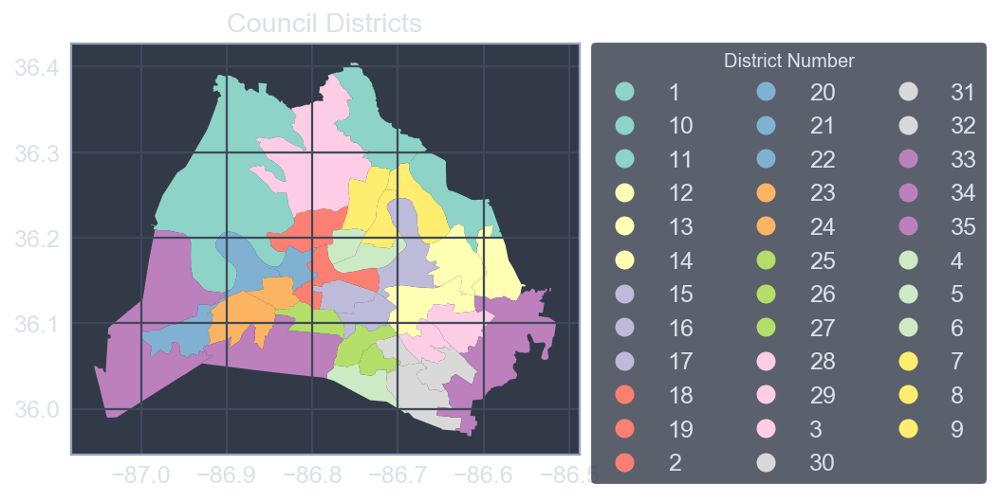

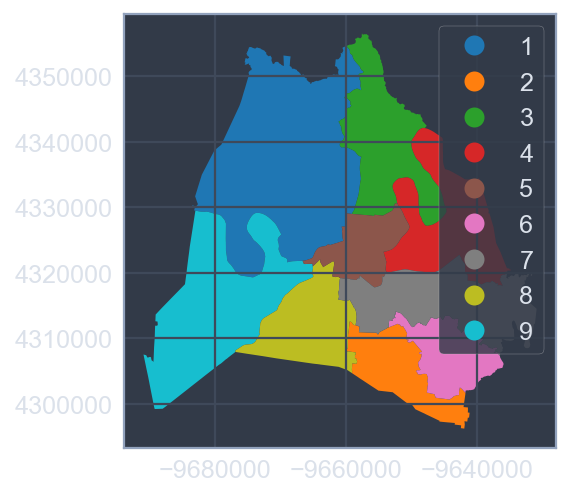

In [38]:
leg_kwds={'title':'District Number', 'loc': 'upper left', 'bbox_to_anchor':(1, 1.03), 'ncol':3}
council_districts.plot(column='district', cmap='Set3', legend=True, legend_kwds=leg_kwds)
plt.title('Council Districts')
plt.show()

school_districts.plot(column ='district', legend = True)
plt.show()

### The .sjoin() op argument

* operation can be ***intersects***, ***contains***, or ***within***

```python
import geopandas as gpd

gpd.sjoin(blue_region_gdf, black_point_gdf, op = <operation>)
```

### Using .sjoin()

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/Using_sjoin.png' alt='Using .sjoin()' width=400 align='left'>

### op = 'intersects'

```python
gpd.sjoin(blue_region_gdf, black_point_gdf, op = 'intersects')
```

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/op=intersects.png' alt="op = 'intersects'" width=400 align='left'>

### op = 'contains'

```python
gpd.sjoin(blue_region_gdf, black_point_gdf, op = 'contains')
```

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/op=contains.png' alt="op = 'contains'" width=400 align='left'>

### op = 'within'

```python
gpd.sjoin(black_point_gdf, blue_region_gdf, op = 'within')
```

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/op=within.png' alt="op = 'within'" width=400 align='left'>

### The sjoin.() op argument - within

In [39]:
# find council districts within school districts
within_gdf = gpd.sjoin(council_districts, school_districts, op='within')
print('council districts within school districts: ', within_gdf.shape[0])

council districts within school districts:  0


### The sjoin.() op argument - contains

In [40]:
# find school districts that contain council districts

contains_gdf = gpd.sjoin(school_districts, council_districts, op='contains')
print('school districts contain council districts: ', contains_gdf.shape[0])

school districts contain council districts:  0


### The sjoin.() op argument - intersects

In [41]:
# find council districts that intersect with school districts

intersect_gdf = gpd.sjoin(council_districts, school_districts, op='intersects')
print('council districts intersect school districts: ', intersect_gdf.shape[0])

council districts intersect school districts:  0


### Columns in a spatially joined GeoDataFrame

In [42]:
within_gdf = gpd.sjoin(council_districts, school_districts, op = 'within')
within_gdf.head()

,first_name_left,email_left,res_phone,bus_phone,last_name_left,position_left,district_left,geometry,index_right,first_name_right,city,zip,email_right,state,last_name_right,address,position_right,term_expir,district_right,phone


### Aggregating spatially joined data

```python
# Aggregate council districts by school district
# to see how many council districts are within each school district.

# first rename district_left and district_right
within_gdf.district_left = council_district
within_gdf.district_right = school_district

within_gdf[['council_district','school_district']
          ].groupby('school_district'
                   ).agg('count'
                        ).sort_values('council_district', ascending = False)
```

```
council_district   school_district
               3                 3
               1                 2
               9                 2
               2                 1
               5                 1
               6                 1
               8                 1
```

### №15 Spatial join practice

1. Write a spatial join to find the art in `art_geo` that intersects with `neighborhoods`. Call this `art_intersect_neighborhoods` and print the `.shape` property to see how many rows and columns resulted

In [43]:
art_intersect_neighborhoods = gpd.sjoin(art_geo, neighborhoods, op = 'intersects')
print(art_intersect_neighborhoods.shape)

(40, 13)


2. Now write a spatial join to find the art in `art_geo` that is within `neighborhoods`. Call this `art_within_neighborhoods` and take a look at the `.shape` property to see how many rows and columns resulted

In [44]:
art_intersect_neighborhoods = gpd.sjoin(art_geo, neighborhoods, op = 'within')
print(art_intersect_neighborhoods.shape)

(40, 13)


3. Finally, write a spatial join to find the art locations in `art_geo` that contain `neighborhoods`. Call this GeoDataFrame `art_containing_neighborhoods` and take a look at the `.shape` property to see how many rows and columns resulted

In [45]:
art_intersect_neighborhoods = gpd.sjoin(art_geo, neighborhoods, op = 'contains')
print(art_intersect_neighborhoods.shape)

(0, 13)


### №16 Finding the neighborhood with the most public art

* Merge the `art_geo` and `neighborhoods` GeoDataFrames with a spatial join to create a new GeoDataFrame called `neighborhood_art`. Find the art that is `within` `neighborhoods`
* Print the first few rows of the neighborhood art GeoDataFrame

In [46]:
import geopandas as gpd
import pandas as pd

neighborhood_art = gpd.sjoin(art_geo, neighborhoods, op = 'within')
print(neighborhood_art.head())

                                Title Last Name First Name  \
1     [Fourth and Commerce Sculpture]    Walker        Lin   
4                A Story of Nashville    Ridley       Greg   
21                        Chet Atkins     Faxon    Russell   
22  Children's Chairs For The Seasons    McGraw     Deloss   
34                    Foliated Scroll   Bloomer       Kent   

                                             Location  \
1                   333 Commerce Street, Nashville TN   
4                     615 Church Street, Nashville TN   
21  Corner of Fifth Avenue North and Union Street,...   
22                    615 Church Street, Nashville TN   
34                    615 Church Street, Nashville TN   

                                         Medium       Type  \
1                                           NaN  Sculpture   
4                      Hammered copper repousse     Frieze   
21  Bronze stool and guitar on a granite plynth  Sculpture   
22                 Mixed Media - woo

### №17 Aggregating points within polygons

* Get just `name` and `title` from `neighborhood_art` and then group by each neighborhood's name (`name`). Save this as `neighborhood_art_grouped`
* Aggregate `neighborhood_art_grouped` to see how many artworks are within each polygon. Use the `.agg('count')` function to get a count of art in each neighborhood and sort the results with `.sort_values()`, sorting by `title` with ascending set to `False`. Print it

In [47]:
neighborhood_art_grouped = neighborhood_art[['name', 'Title']].groupby('name')
print(neighborhood_art_grouped.agg('count').sort_values(by = 'Title', ascending = False))

                          Title
name                           
Urban Residents              22
Lockeland Springs             3
Edgehill (ONE)                2
Germantown                    2
Hillsboro-West End            2
Inglewood                     2
Sunnyside                     2
Chestnut Hill (TAG)           1
Historic Edgefield            1
McFerrin Park                 1
Renraw                        1
Wedgewood Houston (SNAP)      1


### №18 Plotting the Urban Residents neighborhood and art

* Create a GeoDataFrame called `urban_art` using the `.loc[]` accessor to get only the art in the `'Urban Residents'` neighborhood
* Use `.loc[]` again to create a GeoDataFrame called `urban_polygon` from `neighborhoods` with only the `'Urban Residents'` polygon
* Plot `urban_polygon` as `ax` and set `color` to `lightgreen`
* Plot the art in `urban_art`. Pass three arguments: Set `ax = ax` to add this plot to the `urban_polygon`, use type to label the points, and set `legend = True`

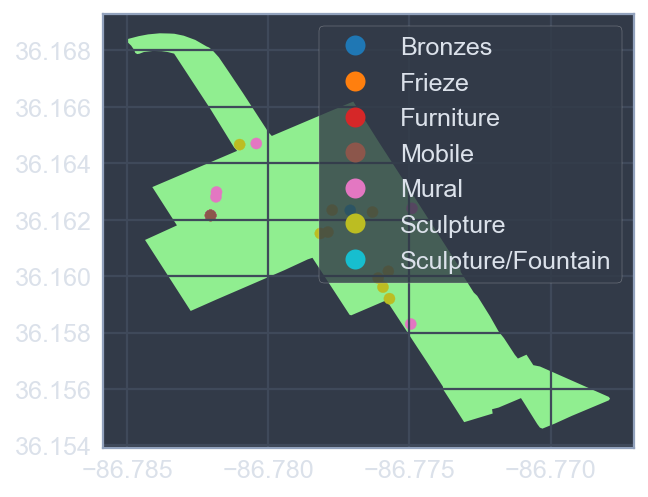

In [48]:
urban_art = neighborhood_art.loc[neighborhood_art.name == 'Urban Residents']
urban_polygon = neighborhoods.loc[neighborhoods.name == 'Urban Residents']

ax = urban_polygon.plot(color = 'lightgreen')

urban_art.plot(ax = ax, column = 'Type', legend = True);
plt.show()

## Chapter 3. GeoSeries and folium

## 7. GeoSeries attributes and methods I

### Shapely attributes and methods

* `GeoSeries.area` - returns the area of each geometry in a GeoSeries
* `GeoSeries.centroid` - returns the center point of each geometry in a GeoSeries
* `GeoSeries.distance(other)` - returns the minimum distance to other

In [49]:
# the geometry column is a GeoSeries
type(school_districts.geometry)

geopandas.geoseries.GeoSeries

### GeoSeries.area

* returns the area of each geometry in a GeoSeries

In [50]:
# area of first polygon in districts
print(school_districts.geometry[0].area)

563134380.266976


### School district areas

**GEOSERIES.AREA**

In [51]:
# print the first 5 rows of school districts and the total number of rows
print(school_districts.head())
print()
print('There are ', school_districts.shape[0],' school districts.' )

   first_name       city    zip                           email state  \
0  Dr. Sharon  Nashville  37218  gentryfordistrict1@comcast.net    TN   
1        Jill    Madison  37115          jill.speering@mnps.org    TN   
2  Dr. Jo Ann  Nashville  37220          joann.brannon@mnps.org    TN   
3        Anna  Hermitage  37076          anna.shepherd@mnps.org    TN   
4         Amy  Nashville  37221             amy.frogge@mnps.org    TN   

  last_name                address    position term_expir district  \
0    Gentry        6108 Beals Lane      Member       2016        1   
1  Speering      1033 Falls Avenue  Vice-Chair       2016        3   
2   Brannon  5444 San Marcos Drive      Member       2018        2   
3  Shepherd     4545 Raccoon Trail       Chair       2018        4   
4    Frogge  7237 Riverfront Drive      Member       2016        9   

          phone                                           geometry  
0  615-268-5269  (POLYGON ((-9659344.055955959 4353528.76657080...  
1 

In [52]:
# calculate area of each school district
district_area = school_districts.geometry.area
# print the areas and crs used
print(district_area.sort_values(ascending = False))
print(school_districts.crs)

0    5.631344e+08
4    3.532321e+08
8    2.301357e+08
1    2.183699e+08
3    2.168715e+08
5    1.641375e+08
2    1.276154e+08
7    1.197423e+08
6    9.846963e+07
dtype: float64
{'init': 'epsg:3857', 'no_defs': True}


In [53]:
# create a copy of school_districts that uses EPSG:3857
school_districts_3857 = school_districts.to_crs(epsg = 3857)
# define a variable for m^2 to km^2
sqm_to_sqkm = 10**6

# get area in kilometers squared
district_area_km = school_districts_3857.geometry.area / sqm_to_sqkm
print(district_area_km.sort_values(ascending = False))
print(school_districts_3857.crs)

0    563.134380
4    353.232132
8    230.135653
1    218.369949
3    216.871511
5    164.137548
2    127.615396
7    119.742279
6     98.469632
dtype: float64
{'init': 'epsg:3857', 'no_defs': True}


### №19 Find the area of the Urban Residents neighborhood

* Print the urban polygon and notice the units of each longitude/latitude pair
* Create `urban_poly_3857` by calling `to_crs()` on `urban_polygon` and print the head again. Notice the units of each longitude/latitude pair have changed
* Print the area of the `urban_poly_3857` geometry. Remember to divide by `10**6` to get kilometers squared

In [54]:
print(urban_polygon.head())

urban_poly_3857 = urban_polygon.to_crs(epsg = 3857)
print(urban_poly_3857.head())

area = urban_poly_3857.geometry.area / 10**6
print('The area of the Urban Residents neighborhood is ', area[41], ' km squared')

               name                                           geometry
41  Urban Residents  (POLYGON ((-86.78122053774267 36.1645653773768...
               name                                           geometry
41  Urban Residents  (POLYGON ((-9660441.280680289 4323289.00479539...
The area of the Urban Residents neighborhood is  1.1289896057982676  km squared


## 8. GeoSeries attributes and methods II

### GeoSeries.centroid

* returns the point at the center of each geometry in a GeoSeries

POINT (-9669306.578090124 4336855.418278825)


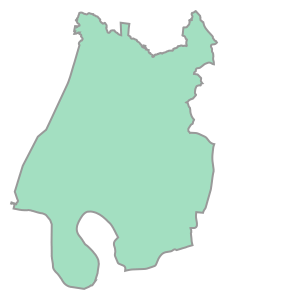

In [55]:
# centroid of first polygon
print(school_districts.geometry.centroid[0])
school_districts.geometry[0]

### School district centroids

**GEOSERIES.CENTROID**

In [56]:
# print the first 5 rows of school districts
print(school_districts.head())

   first_name       city    zip                           email state  \
0  Dr. Sharon  Nashville  37218  gentryfordistrict1@comcast.net    TN   
1        Jill    Madison  37115          jill.speering@mnps.org    TN   
2  Dr. Jo Ann  Nashville  37220          joann.brannon@mnps.org    TN   
3        Anna  Hermitage  37076          anna.shepherd@mnps.org    TN   
4         Amy  Nashville  37221             amy.frogge@mnps.org    TN   

  last_name                address    position term_expir district  \
0    Gentry        6108 Beals Lane      Member       2016        1   
1  Speering      1033 Falls Avenue  Vice-Chair       2016        3   
2   Brannon  5444 San Marcos Drive      Member       2018        2   
3  Shepherd     4545 Raccoon Trail       Chair       2018        4   
4    Frogge  7237 Riverfront Drive      Member       2016        9   

          phone                                           geometry  
0  615-268-5269  (POLYGON ((-9659344.055955959 4353528.76657080...  
1 

### School district centroids

In [57]:
# create 'center` column from the centroid
school_districts['center'] = school_districts.geometry.centroid

In [58]:
# create GeoDataFrame with districts and centers
part = ['district','center']
school_district_centers = school_districts[part]
school_district_centers.head()

,district,center
0,1,POINT (-9669306.578090124 4336855.418278825)
1,3,POINT (-9654029.683996843 4339936.352045468)
2,2,POINT (-9651575.219040638 4304781.40552222)
3,4,POINT (-9644681.594034612 4327762.316595967)
4,9,POINT (-9679704.60625392 4314937.563265621)


### GeoSeries.distance()

* GeoSeries.distance(other) - returns minimum distance to other

```python
# distance from red_pt to centroid
cen = school_districts.geometry.centroid[0]
print(red_pt.distance(other = cen))
```

### Distance between two points

**GEOSERIES.DISTANCE(OTHER)**

In [59]:
district_one = school_districts.loc[school_districts.district == '1']
district_one.head()

,first_name,city,zip,email,state,last_name,address,position,term_expir,district,phone,geometry,center
0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,(POLYGON ((-9659344.055955959 4353528.76657080...,POINT (-9669306.578090124 4336855.418278825)


### Distance between two points

In [60]:
schools.head()

,School ID,School Name,Street Address,City,State,ZIP Code,Phone Number,School State ID,School Level,Lowest Grade,Highest Grade,Latitude,Longitude,School Website,Cluster,Mapped Location
0,496,A. Z. Kelley Elementary,5834 Pettus Road,Antioch,TN,37013,(615)941-7535,1,Elementary School,Grade P3,Grade 4,36.021817,-86.658848,http://schools.mnps.org/az-kelley-elementary-s...,Cane Ridge,"(36.02181712, -86.65884778)"
1,375,Alex Green Elementary,3921 Lloyd Road,Whites Creek,TN,37189,(615)876-5105,5,Elementary School,Grade P4,Grade 4,36.252961,-86.832229,http://schools.mnps.org/alex-green-elementary-...,Whites Creek,"(36.2529607, -86.8322292)"
2,105,Amqui Elementary,319 Anderson Lane,Madison,TN,37115,(615)612-3678,10,Elementary School,Grade P3,Grade 4,36.273766,-86.703832,http://schools.mnps.org/amqui-elementary-school,Hunters Lane,"(36.27376585, -86.70383153)"
3,460,Andrew Jackson Elementary,110 Shute Ln,Old Hickory,TN,37138,(615)847-7317,15,Elementary School,Grade P4,Grade 4,36.231585,-86.623775,http://schools.mnps.org/andrew-jackson-element...,McGavock,"(36.23158465, -86.62377469)"
4,110,Antioch High School,1900 Hobson Pike,Antioch,TN,37013,(615)641-5400,20,High School,Grade 9,Grade 12,36.046675,-86.599418,http://schools.mnps.org/antioch-high-school,Antioch,"(36.04667464, -86.59941833)"


In [61]:
# create geometry in schools
schools['geometry'] = schools.apply(lambda x: Point((x.Longitude, x.Latitude)), axis=1)
# define crs
s_crs = district_one.crs
#construct schools GeoDataFrame
school_geo = gpd.GeoDataFrame(schools, crs = s_crs, geometry = schools.geometry)

### Distance between two points

In [62]:
# spatial join schools within dist 1
schools_in_dist1 = gpd.sjoin(schools_geo, district_one, op = 'within')
schools_in_dist1.shape

(30, 17)

### Distance between two points

In [63]:
# import pprint to format dictionary output
import pprint

distances = {}
for row in schools_in_dist1.iterrows():
    vals = row[1]
    key = vals['School Name']
    ctr = vals['center']
    distances[key] = vals['geometry'].distance(ctr)
    pprint.pprint(distances)

{'Alex Green Elementary': 3469.412137359045}
{'Alex Green Elementary': 3469.412137359045,
 'Bellshire Elementary': 11011.541990235706}
{'Alex Green Elementary': 3469.412137359045,
 'Bellshire Elementary': 11011.541990235706,
 'Brick Church College Prep': 10554.494728733529}
{'Alex Green Elementary': 3469.412137359045,
 'Bellshire Elementary': 11011.541990235706,
 'Brick Church College Prep': 10554.494728733529,
 'Buena Vista Elementary': 13667.466043840843}
{'Alex Green Elementary': 3469.412137359045,
 'Bellshire Elementary': 11011.541990235706,
 'Brick Church College Prep': 10554.494728733529,
 'Buena Vista Elementary': 13667.466043840843,
 'Cockrill Elementary': 14822.517133556596}
{'Alex Green Elementary': 3469.412137359045,
 'Bellshire Elementary': 11011.541990235706,
 'Brick Church College Prep': 10554.494728733529,
 'Buena Vista Elementary': 13667.466043840843,
 'Cockrill Elementary': 14822.517133556596,
 'Creswell Middle Prep School of the Arts': 9580.788400451804}
{'Alex Green 

{'Alex Green Elementary': 3469.412137359045,
 'Bellshire Elementary': 11011.541990235706,
 'Brick Church College Prep': 10554.494728733529,
 'Buena Vista Elementary': 13667.466043840843,
 'Cockrill Elementary': 14822.517133556596,
 'Creswell Middle Prep School of the Arts': 9580.788400451804,
 'Cumberland Elementary': 7043.03176310636,
 'Haynes Middle': 11042.258127502482,
 'Hull-Jackson Elementary': 11662.117794424365,
 'Ivanetta H. Davis Learning Center at Bordeaux': 10329.183155522947,
 'Joelton Elementary': 7334.060215726456,
 'Joelton Middle': 7058.325312491858,
 'John Early Middle': 12177.651416624525,
 'Jones Elementary': 13077.68942096559,
 'KIPP Nashville College Prep': 7263.267087269757,
 'KIPP Nashville College Prep Elementary': 7218.329447249823,
 'Moses McKissack Middle': 14569.890778837316,
 'Nashville Academy of Computer Science': 9540.260064144419,
 'Nashville Prep': 13891.597271654007,
 'Purpose Prep': 11994.548462938763,
 'RePublic High School': 9520.969102461762}
{'A

### №20 The center of the Urban Residents neighborhood

* Create downtown_center, from `urban_poly_3857` using the GeoSeries `centroid` attribute.
Print the datatype of `downtown_center`
* Plot `urban_poly_3857` as `ax` using `lightgreen` for the `color`
* Plot the `downtown_center`, setting `ax = ax` and `color = black`

<class 'geopandas.geoseries.GeoSeries'>


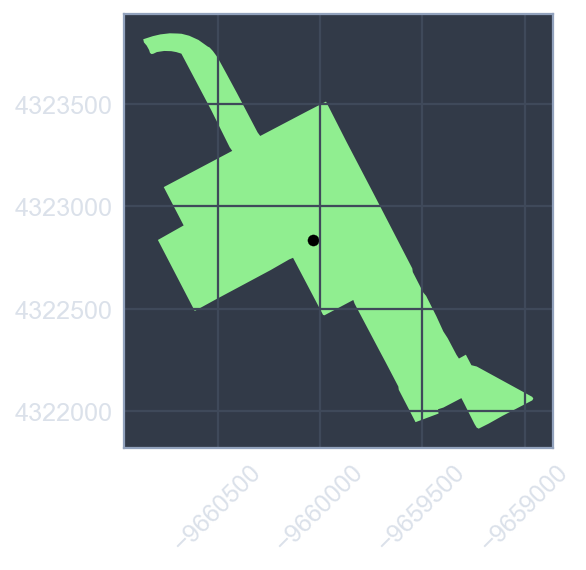

In [64]:
downtown_center = urban_poly_3857.geometry.centroid
print(type(downtown_center))

ax = urban_poly_3857.plot(color = 'lightgreen')
downtown_center.plot(ax = ax, color = 'black')
plt.xticks(rotation = 45)

plt.show()

### №21 Prepare to calculate distances

* Create a GeoDataFrame called `art_dist_meters`, using the `art` DataFrame and the geometry column from `art`. Set `crs = {'init': 'epsg:4326'}` since the geometry is in decimal degrees. * Print the first two rows
Now explicitly set the coordinate reference system to `EPSG:3857` for `art_dist_meters` by using `to_crs()`. Print the first two rows again
* Add a column called `center` to `art_dist_meters`, setting it equal to `center_point` for every row 

In [65]:
from shapely.geometry import Point
import geopandas as gpd
import pandas as pd

center_point = Point(urban_poly_3857.geometry.centroid[41])

art_dist_meters = gpd.GeoDataFrame(art, geometry = art.geometry, crs = {'init': 'epsg:4326'})
print(art_dist_meters.head(2))

art_dist_meters.geometry = art_dist_meters.geometry.to_crs(epsg = 3857)
print(art_dist_meters.head(2))

art_dist_meters['center'] = center_point

                             Title Last Name First Name  \
0          [Cross Country Runners]     Frost      Miley   
1  [Fourth and Commerce Sculpture]    Walker        Lin   

                            Location  Medium       Type Description  Latitude  \
0     4001 Harding Rd., Nashville TN  Bronze  Sculpture         NaN  36.12856   
1  333 Commerce Street, Nashville TN     NaN  Sculpture         NaN  36.16234   

   Longitude        Mapped Location                             geometry  
0  -86.83660   (36.12856, -86.8366)            POINT (-86.8366 36.12856)  
1  -86.77774  (36.16234, -86.77774)  POINT (-86.77774000000001 36.16234)  
                             Title Last Name First Name  \
0          [Cross Country Runners]     Frost      Miley   
1  [Fourth and Commerce Sculpture]    Walker        Lin   

                            Location  Medium       Type Description  Latitude  \
0     4001 Harding Rd., Nashville TN  Bronze  Sculpture         NaN  36.12856   
1  333 Commer

### №22 Art distances from neighborhood center

* Import the package to help with pretty printing`
* Create a dictionary, `art_distances` by iterating through `art_dist_meters`, using `title` as the key and the `distance()` from center as the value. Pass `center` as the `other` argument to `GeoSeries.distance()`
* Pretty print `art_distances` using the `pprint` method of `pprint`

In [66]:
import pprint

art_distances = {}
for row in art_dist_meters.iterrows():
    vals = row[1]
    key = vals['Title']
    ctr = vals['center']
    art_distances[key] = vals['geometry'].distance(ctr)

pprint.pprint(art_distances)

{'12th & Porter Mural': 1269.150287911304,
 'A Splash of Color': 2471.774738456058,
 'A Story of Nashville': 513.5632030476819,
 'Aerial Innovations Mural': 4516.755210409467,
 'Airport Sun Project': 12797.594229782726,
 'Andrew Jackson': 948.9812821666546,
 'Angel': 10202.565989737886,
 'Anticipation': 688.8349105300488,
 'April Baby': 4779.394424948614,
 'Arial Triangle [from the Gravity Series]': 4315.322141144408,
 'Ariel': 4380.9277739551535,
 'Athena Parthenos': 4294.778095688652,
 'Benedictio': 5313.6242142909305,
 'Bicycle Bus-Green Fleet': 468.0828635562599,
 'Blowing Bubbles': 10202.565989737886,
 'Breaking Bread': 1279.2562933073418,
 'Building a Positive Community': 2253.4179974184162,
 'Can-Do': 5648.086322079543,
 'Chet Atkins': 604.4489448122729,
 "Children's Chairs For The Seasons": 513.5632030476819,
 'Confederate Memorial': 5313.6242142909305,
 'Confederate Private Monument': 4316.459103418228,
 'Confluence': 2918.5244121040123,
 'Cool Fences': 6491.846030114518,
 'Da

## 9. Working with Folium

### Folium

* python package
* interactive maps
* built upon Leaflet.js

### folium.Map()

In [67]:
import folium
# construct a map centered at the Eiffel Tower
eiffel_tower = folium.Map(location = [48.8583736,2.2922926])
# display the map
display(eiffel_tower)

### Setting the zoom level

In [68]:
import folium
# construct a map centered at the Eiffel Tower
eiffel_tower = folium.Map(location=[48.8583736,2.2922926], zoom_start = 12)

# display the map
display(eiffel_tower)

### Folium location from centroid

In [69]:
district_one.head()

,first_name,city,zip,email,state,last_name,address,position,term_expir,district,phone,geometry,center
0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,(POLYGON ((-9659344.055955959 4353528.76657080...,POINT (-9669306.578090124 4336855.418278825)


In [70]:
center_point = district_one.center[0]
type(center_point)

shapely.geometry.point.Point

### Folium location from centroid

In [71]:
# reverse the order for folium location array
district_center = [center_point.y, center_point.x]
# print center point and district_center
print(center_point)
print(district_center)

POINT (-9669306.578090124 4336855.418278825)
[4336855.418278825, -9669306.578090124]


### Adding a polygon to a folium map

In [72]:
# create a folium map centered on district 1
district1_map = folium.Map(location = district_center)

# add the outline of district one
folium.GeoJson(district_one.geometry).add_to(district1_map)

# display the resulting map
display(district1_map)

### №23 Create a folium location from the urban centroid

* Print the head of `urban_polygon`, which is in your workspace
* Store the first occurrence of center as `urban_center` and print `urban_center`
* Create an array from `urban_center` that reverses the order of longitude and latitude. Call this `urban_location`
* Print `urban_location`

In [73]:
print(urban_polygon.head())

urban_polygon.center = urban_polygon.geometry.centroid
urban_center = urban_polygon.center[41]
print(urban_center)

urban_location = [urban_center.y, urban_center.x]
print(urban_location)

               name                                           geometry
41  Urban Residents  (POLYGON ((-86.78122053774267 36.1645653773768...
POINT (-86.77756457127047 36.16127820928791)
[36.161278209287914, -86.77756457127047]


### №24 Create a folium map of downtown Nashville

* Construct a folium map called `downtown_map`. Use the `urban_location` array you created in the previous exercise and set the initial zoom level to 15
* Display your folium map object with the provided `display` function

In [74]:
downtown_map = folium.Map(location=urban_location, zoom_start=15)
display(downtown_map)

### №25 Folium street map of the downtown neighborhood

* Create an array called `folium_loc` from `urban_polygon.center`
* Create a folium map called `downtown_map`. Set the location argument equal to `folium_loc` and initialize the map with a `zoom_start` of 15
* Pass the geometry from the urban_polygon GeoDataFrame to the `folium.GeoJson()` method. Then call `add_to()` on that

In [75]:
urban_polygon.center = urban_polygon.geometry.centroid
point = urban_polygon.center[41]
folium_loc = [point.y, point.x]

downtown_map = folium.Map(location=folium_loc, zoom_start=15)

folium.GeoJson(urban_polygon.geometry).add_to(downtown_map)

display(downtown_map)

## 10. Creating markers and popups in folium

### Using iterrows()

In [76]:
for row in schools_in_dist1.iterrows():
    row_values = row[1]
    print(row_values)

School Name                           Alex Green Elementary
Latitude                                             36.253
Longitude                                          -86.8322
geometry       POINT (-9666119.538988819 4335484.432376049)
index_right                                               0
first_name                                       Dr. Sharon
city                                              Nashville
zip                                                   37218
email                        gentryfordistrict1@comcast.net
state                                                    TN
last_name                                            Gentry
address                                     6108 Beals Lane
position                                             Member
term_expir                                             2016
district                                                  1
phone                                          615-268-5269
center         POINT (-9669306.578090124

School Name           Nashville Academy of Computer Science
Latitude                                             36.235
Longitude                                          -86.7825
geometry       POINT (-9660579.852546908 4333000.444428733)
index_right                                               0
first_name                                       Dr. Sharon
city                                              Nashville
zip                                                   37218
email                        gentryfordistrict1@comcast.net
state                                                    TN
last_name                                            Gentry
address                                     6108 Beals Lane
position                                             Member
term_expir                                             2016
district                                                  1
phone                                          615-268-5269
center         POINT (-9669306.578090124

### Building marker locations

In [77]:
schools_in_dist1.head()

,School Name,Latitude,Longitude,geometry,index_right,first_name,city,zip,email,state,last_name,address,position,term_expir,district,phone,center
1,Alex Green Elementary,36.252961,-86.832229,POINT (-9666119.538988819 4335484.432376049),0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,POINT (-9669306.578090124 4336855.418278825)
8,Bellshire Elementary,36.269688,-86.762300,POINT (-9658335.084996307 4337793.71263299),0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,POINT (-9669306.578090124 4336855.418278825)
9,Brick Church College Prep,36.220739,-86.781752,POINT (-9660500.492881922 4331037.323892795),0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,POINT (-9669306.578090124 4336855.418278825)
10,Buena Vista Elementary,36.177741,-86.798138,POINT (-9662324.529530264 4325105.923567676),0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,POINT (-9669306.578090124 4336855.418278825)
20,Cockrill Elementary,36.156206,-86.845145,POINT (-9667557.311475644 4322136.482159456),0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,POINT (-9669306.578090124 4336855.418278825)


In [78]:
# Construct a folium map for school district 1
district1_map = folium.Map(location = district_center, zoom_start = 11)

#create a marker for each school
for row in schools_in_dist1.iterrows():
    row_values = row[1]
    location = [row_values['Latitude'], row_values['Longitude']]
    marker = folium.Marker(location = location)
    marker.add_to(district1_map)
    
display(district1_map)

### Creating popups from data in a DataFrame

In [79]:
# Construct a folium map for school district 1
district1_map = folium.Map(location = district_center, zoom_start = 11)

# Create a marker for each school
for row in schools_in_dist1.iterrows():
    row_values = row[1]
    location = [row_values['Latitude'], row_values['Longitude']]
    popup = popup = '<strong>' + row_values['School Name'] + '</strong>'
    marker = folium.Marker(location = location, popup = popup)
    marker.add_to(district1_map)
    
display(district1_map)

### №26 Adding markers for the public art

* First take a look at the tuple returned by `iterrows()` by printing the first and second values
* Assign the second value of the `iterrows()` tuple to `row_values`. Create a location formatted for `folium`, use it to build a marker, and add it to the `downtown_map`
* Display the map

In [80]:
for row in urban_art.iterrows():
    print('first part: ', row[0])
    print('second part: ', row[1])

for row in urban_art.iterrows():
    row_values = row[1] 
    location = [row_values['Latitude'], row_values['Longitude']]
    marker = folium.Marker(location=location)
    marker.add_to(downtown_map)

display(downtown_map)

first part:  1
second part:  Title                  [Fourth and Commerce Sculpture]
Last Name                                       Walker
First Name                                         Lin
Location             333 Commerce Street, Nashville TN
Medium                                             NaN
Type                                         Sculpture
Description                                        NaN
Latitude                                       36.1623
Longitude                                     -86.7777
Mapped Location                  (36.16234, -86.77774)
geometry           POINT (-86.77774000000001 36.16234)
index_right                                         41
name                                   Urban Residents
Name: 1, dtype: object
first part:  4
second part:  Title                                           A Story of Nashville
Last Name                                                     Ridley
First Name                                                      Gr

### №27 Troubleshooting data issues

* Print and inspect the values in the `title` column of the `urban_art` DataFrame
* Print and inspect the values in the `desc` column of the `urban_art` DataFrame
* Use the `fillna()` method to replace the `NaN` values in the `desc` column with empty strings, and use `.str.replace` to replace the apostrophes (') with back-ticks (`)
* Print the descriptions again to verify your work

In [81]:
print(urban_art.Title)
print()
print(urban_art.Description)

urban_art.Description.fillna('', inplace = True)
urban_art.Description = urban_art.Description.str.replace("'", "`")
print()
print(urban_art.Description)

1                        [Fourth and Commerce Sculpture]
4                                   A Story of Nashville
21                                           Chet Atkins
22                     Children's Chairs For The Seasons
34                                       Foliated Scroll
39                                          Gone Fishing
40                             Happy Times at The Arcade
54                                     Johnny Cash Mural
55                                 La Storia della Terra
57                                 Les Paul Guitar Mural
59                                         Library Doors
60                               Lightning Wire Fountain
66     Nashville, A History through Maps and Aerial V...
67                                               Oh, Roy
68                                  Orpheus and Eurydice
75                               Piecing It All Together
104                                  The Birth of Apollo
105                            

### №28 A map of downtown art

* For each row in `urban_art`, build a popup message that includes the title and description for the corresponding artwork
* Complete the code to replace all instances of single quotes (`'`) with backticks (```) in the `popup` messages
* Display the finished map

In [82]:
nashville = [36.16127820928791, -86.77756457127047]

downtown_map = folium.Map(location = nashville, zoom_start = 15)
folium.GeoJson(urban_polygon).add_to(downtown_map)

for row in urban_art.iterrows():
    row_values = row[1] 
    location = [row_values['Latitude'], row_values['Longitude']]
    popup = (str(row_values['Title']) + ': ' + 
             str(row_values['Description'])).replace("'", "`")
    marker = folium.Marker(location = location, popup = popup)
    marker.add_to(downtown_map)

display(downtown_map)

## Chapter 4. Creating a choropleth building permit density in Nashville

## 11. What is a choropleth?

### Definition of a choropleth

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/Definition_of_a_choropleth.png' alt='Definition of a choropleth' width=500 align='left'>

### Density

In [83]:
schools_in_districts = schools[['City', 'School Name', 'Latitude', 'Longitude', 'geometry']]
schools_in_districts.head(2)

,City,School Name,Latitude,Longitude,geometry
0,Antioch,A. Z. Kelley Elementary,36.021817,-86.658848,POINT (-86.65884778 36.02181712)
1,Whites Creek,Alex Green Elementary,36.252961,-86.832229,POINT (-86.8322292 36.2529607)


### Get counts

In [84]:
school_counts = schools_in_districts.groupby(['City']).size()
print(school_counts)

City
Antioch            20
Brentwood           1
Goodlettsville      3
Hermitage           5
Joelton             2
Madison             7
Nashville         127
Old Hickory         3
Whites Creek        2
dtype: int64


### Add counts

In [85]:
school_counts_df = school_counts.to_frame()
school_counts_df.reset_index(inplace=True)
school_counts_df.columns = ['city','school_count']

In [86]:
city_with_counts = pd.merge(school_districts, school_counts_df, on='city')
city_with_counts.head(2)

,first_name,city,zip,email,state,last_name,address,position,term_expir,district,phone,geometry,center,school_count
0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,(POLYGON ((-9659344.055955959 4353528.76657080...,POINT (-9669306.578090124 4336855.418278825),127
1,Dr. Jo Ann,Nashville,37220,joann.brannon@mnps.org,TN,Brannon,5444 San Marcos Drive,Member,2018,2,615-833-5976,(POLYGON ((-9658854.027487349 4312092.82910009...,POINT (-9651575.219040638 4304781.40552222),127


### Divide counts by area

In [87]:
city_with_counts['area'] = city_with_counts.geometry.area

In [88]:
city_with_counts['school_density'] = city_with_counts.apply(
    lambda row: row.school_count/row.area, axis = 1)

city_with_counts.head(2)

,first_name,city,zip,email,state,last_name,address,position,term_expir,district,phone,geometry,center,school_count,area,school_density
0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,(POLYGON ((-9659344.055955959 4353528.76657080...,POINT (-9669306.578090124 4336855.418278825),127,5.631344e+08,2.255234e-07
1,Dr. Jo Ann,Nashville,37220,joann.brannon@mnps.org,TN,Brannon,5444 San Marcos Drive,Member,2018,2,615-833-5976,(POLYGON ((-9658854.027487349 4312092.82910009...,POINT (-9651575.219040638 4304781.40552222),127,1.276154e+08,9.951777e-07


### №29 Finding counts from a spatial join

* Create a Point `geometry` column in `permits` from `lat` and `lng`
* Create `permits_geo`, a GeoDataFrame, using `permits`, the `crs` from `council_districts`, and the `geometry` from `permits`
* Use a spatial join to find permits issued `within` each council district. Print the first 2 rows
* Create `permit_counts` to show the count of permits within each district, using `groupby()` and `.size()`. Print `permit_counts`

In [89]:
from shapely.geometry import Point

permits = pd.read_csv('Visualizing_Geospatial_Data_in_Python/building_permits_2017.csv')

permits['geometry'] = permits.apply(lambda x: Point((x.lng, x.lat)), axis = 1)

permits_geo = gpd.GeoDataFrame(permits, crs = council_districts.crs,
                               geometry = permits.geometry)

permits_by_district = gpd.sjoin(permits_geo, council_districts, op = 'within')
print(permits_by_district.head(2))

permit_counts = permits_by_district.groupby(['district']).size()
print(permit_counts)

     permit_id      issued      cost        lat        lng  \
0   2017032777  2017-05-24  226201.0  36.198241 -86.742235   
68  2017053890  2017-09-05       0.0  36.185442 -86.768239   

                                geometry  index_right first_name  \
0   POINT (-86.74223499999999 36.198241)            5      Scott   
68  POINT (-86.76823900000001 36.185442)            5      Scott   

                        email     res_phone     bus_phone last_name  \
0   scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   
68  scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   

          position district  
0   Council Member        5  
68  Council Member        5  
district
1     146
10    119
11    239
12    163
13    139
14    261
15    322
16    303
17    786
18    287
19    969
2     399
20    799
21    569
22    291
23    206
24    458
25    435
26    179
27    105
28    119
29    154
3     215
30     79
31    134
32    225
33    355
34    218
35    192
4    

### №30 Council district areas and permit counts

1. Get the area of each council district and store it in a new column, `area`, in the `council_districts` GeoDataFrame. Print the first two rows

In [90]:
council_districts['area'] = council_districts.geometry.area
print(council_districts.head(2))

  first_name                           email     res_phone     bus_phone  \
0       Nick     nick.leonardo@nashville.gov  615-509-6334  615-862-6780   
1    DeCosta  decosta.hastings@nashville.gov  615-779-1565  615-862-6780   

  last_name        position district  \
0  Leonardo  Council Member        1   
1  Hastings  Council Member        2   

                                            geometry      area  
0  (POLYGON ((-86.90738248774342 36.3905151283193...  0.022786  
1  (POLYGON ((-86.75902399986667 36.2309080000732...  0.002927  


2. Next convert `permit_counts` to a DataFrame with the `.to_frame()` method, and print the first two rows

In [91]:
permits_df = permit_counts.to_frame()
print(permits_df.head(2))

            0
district     
1         146
10        119


3. Reset the index using the `inplace = True` argument and set the `columns` attribute to a list with the names `district` and `bldg_permits`. Print the first two rows again to see what `permits_df` looks like now

In [92]:
permits_df.reset_index(inplace=True)
permits_df.columns = ['district', 'bldg_permits']
print(permits_df.head(2))

  district  bldg_permits
0        1           146
1       10           119


4. Create a new GeoDataFrame called `districts_and_permits` by merging `council_districts` and `permits_df` on the `district` column. Take a look at the first two rows

In [93]:
districts_and_permits = pd.merge(council_districts, permits_df, on = 'district')
print(districts_and_permits.head(2))

  first_name                           email     res_phone     bus_phone  \
0       Nick     nick.leonardo@nashville.gov  615-509-6334  615-862-6780   
1    DeCosta  decosta.hastings@nashville.gov  615-779-1565  615-862-6780   

  last_name        position district  \
0  Leonardo  Council Member        1   
1  Hastings  Council Member        2   

                                            geometry      area  bldg_permits  
0  (POLYGON ((-86.90738248774342 36.3905151283193...  0.022786           146  
1  (POLYGON ((-86.75902399986667 36.2309080000732...  0.002927           399  


### №32 Calculating a normalized metric

* Print the `type()` of `districts_and_permits`
* Add one more column to `districts_and_permits`. Use a lambda expression and the `pandas` `apply()` method to divide the number of building permits issued for projects in each council district by the area of that district to get a normalized value for the permits issued
* Print the first five rows of `districts_and_permits`

In [94]:
print(type(districts_and_permits))

districts_and_permits['permit_density'] = districts_and_permits.apply(
    lambda row: row.bldg_permits / row.area, axis = 1)
print(districts_and_permits.head())

<class 'geopandas.geodataframe.GeoDataFrame'>
  first_name                           email     res_phone     bus_phone  \
0       Nick     nick.leonardo@nashville.gov  615-509-6334  615-862-6780   
1    DeCosta  decosta.hastings@nashville.gov  615-779-1565  615-862-6780   
2      Nancy    nancy.vanreece@nashville.gov  615-576-0488  615-862-6780   
3       Bill    bill.pridemore@nashville.gov  615-915-1419  615-862-6780   
4     Robert      robert.swope@nashville.gov  615-308-0577  615-862-6780   

   last_name        position district  \
0   Leonardo  Council Member        1   
1   Hastings  Council Member        2   
2   VanReece  Council Member        8   
3  Pridemore  Council Member        9   
4      Swope  Council Member        4   

                                            geometry      area  bldg_permits  \
0  (POLYGON ((-86.90738248774342 36.3905151283193...  0.022786           146   
1  (POLYGON ((-86.75902399986667 36.2309080000732...  0.002927           399   
2  (POLYGO

## 12. Choropleths with geopandas

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/grayscale_01_01.png' alt='Sequential Colormaps' width=500 align='left'>

### Choropleth with GeoDataFrame.plot()

Text(46.89897437907287, 0.5, 'latitude')

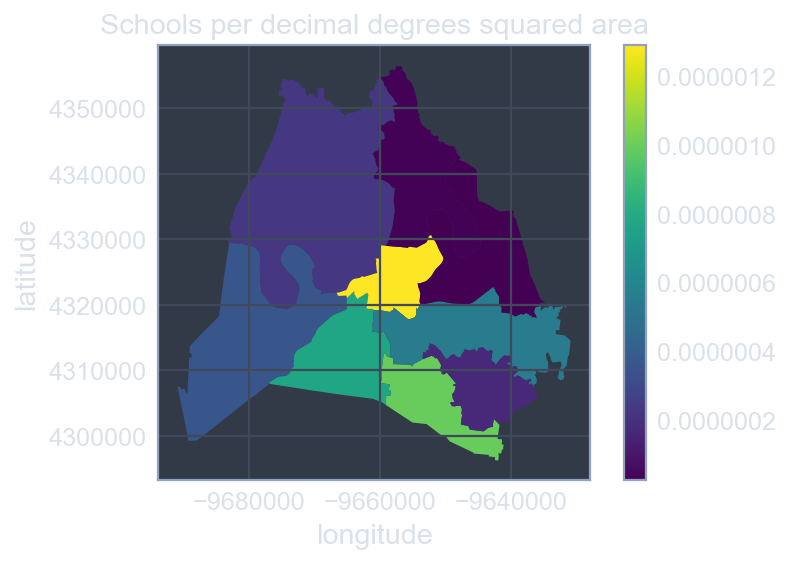

In [95]:
city_with_counts.plot(column = 'school_density', legend = True)
plt.title('Schools per decimal degrees squared area')
plt.xlabel('longitude')
plt.ylabel('latitude')

Text(46.89897437907287, 0.5, 'latitude')

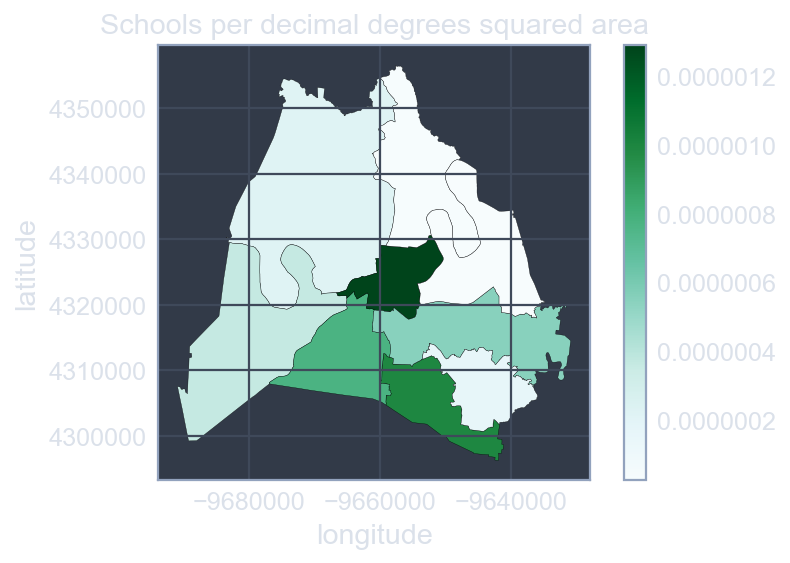

In [96]:
city_with_counts.plot(column = 'school_density', cmap = 'BuGn',
                      edgecolor = 'black', legend = True)
plt.title('Schools per decimal degrees squared area')
plt.xlabel('longitude')
plt.ylabel('latitude')

### Area in Kilometers Squared

In [97]:
# starting CRS
print(school_districts.crs)

{'init': 'epsg:3857', 'no_defs': True}


In [98]:
# convert to EPSG 3857
school_districts = school_districts.to_crs(epsg = 3857)
print(school_districts.crs)

{'init': 'epsg:3857', 'no_defs': True}


In [99]:
# define a variable for m^2 to km^2
sqm_to_sqkm = 10**6
school_districts['area'] = school_districts.geometry.area / sqm_to_sqkm
school_districts.head(2)

,first_name,city,zip,email,state,last_name,address,position,term_expir,district,phone,geometry,center,area
0,Dr. Sharon,Nashville,37218,gentryfordistrict1@comcast.net,TN,Gentry,6108 Beals Lane,Member,2016,1,615-268-5269,(POLYGON ((-9659344.055955959 4353528.76657080...,POINT (-9669306.578090124 4336855.418278825),563.134380
1,Jill,Madison,37115,jill.speering@mnps.org,TN,Speering,1033 Falls Avenue,Vice-Chair,2016,3,615-562-5234,(POLYGON ((-9657371.823286682 4356392.67733572...,POINT (-9654029.683996843 4339936.352045468),218.369949


### Latitude and longitude in decimal degrees

In [100]:
# change crs back to 4326
school_districts = school_districts.to_crs(epsg = 4326)
print(school_districts.crs)

{'init': 'epsg:4326', 'no_defs': True}


In [101]:
print(school_districts.head(2))

   first_name       city    zip                           email state  \
0  Dr. Sharon  Nashville  37218  gentryfordistrict1@comcast.net    TN   
1        Jill    Madison  37115          jill.speering@mnps.org    TN   

  last_name            address    position term_expir district         phone  \
0    Gentry    6108 Beals Lane      Member       2016        1  615-268-5269   
1  Speering  1033 Falls Avenue  Vice-Chair       2016        3  615-562-5234   

                                            geometry  \
0  (POLYGON ((-86.77136400034288 36.3835669997190...   
1  (POLYGON ((-86.75364713283636 36.4042760799855...   

                                         center        area  
0  POINT (-9669306.578090124 4336855.418278825)  563.134380  
1  POINT (-9654029.683996843 4339936.352045468)  218.369949  


In [102]:
# spatial join to get districts that contain schools
schools_in_districts = gpd.sjoin(school_districts, schools_geo, op = 'contains')

### Counting schools in each district

In [103]:
# aggregate to get counts
school_counts = schools_in_districts.groupby(['city']).size()

In [104]:
# convert school_counts to a df
school_counts_df = school_counts.to_frame()
school_counts_df.reset_index(level=0, inplace=True)
school_counts_df.columns = ['city', 'school_count']

In [105]:
# merge
city_with_counts = pd.merge(school_districts, school_counts_df, on = 'city')
city_with_counts.head(2)

,first_name,city,zip,email,state,last_name,address,position,term_expir,district,phone,geometry,center,area,school_count


### №33 Geopandas choropleths

1. Import `matplotlib.pyplot`, `pandas`, and `geopandas` with the customary aliases

In [106]:
import matplotlib.pyplot as plt
import pandas as pd
import geopandas as gpd

2. Plot `districts_and_permits`, using the `permit_density` column you just created and the default colormap. Be sure to call `plt.show()`

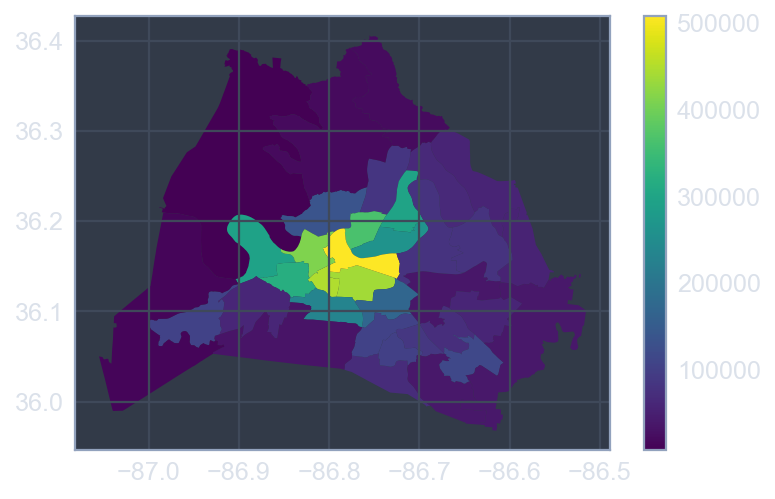

In [107]:
districts_and_permits.plot(column = 'permit_density', legend = True);
plt.show()

3. Create a more polished choropleth of `permit_density`. Use the `BuGn` colormap, outline the polygons in black, create axis labels (`longitude` and `latitude`), and a title('2017 Building Project Density by Council District'). Show the plot

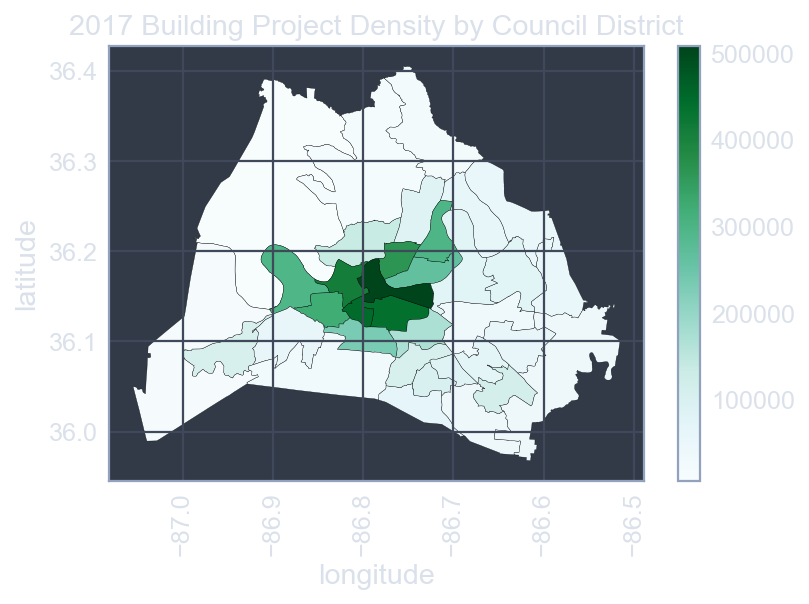

In [108]:
districts_and_permits.plot(column = 'permit_density', cmap = 'BuGn',
                           edgecolor = 'black', legend = True)
plt.xlabel('longitude')
plt.ylabel('latitude')
plt.xticks(rotation = 'vertical')
plt.title('2017 Building Project Density by Council District')
plt.show()

### №34 Area in km squared, geometry in decimal degrees

* Change the coordinate reference system for the `council_districts` to EPSG 3857, and print the `crs` and first two rows again
* Create a column called `area`. Divide the area of each polygon by `sqm_to_sqkm` to get the area in kilometers squared
* Change the coordinate reference system for the `council_districts` back to EPSG 4326. Print the `crs` and first two rows

In [109]:
council_districts = council_districts.to_crs(epsg = 3857)
print(council_districts.crs)
print(council_districts.head(2))

sqm_to_sqkm = 10**6
council_districts['area'] = council_districts.geometry.area / sqm_to_sqkm
print()

council_districts = council_districts.to_crs(epsg = 4326)
print(council_districts.crs)
print(council_districts.head(2))

{'init': 'epsg:3857', 'no_defs': True}
  first_name                           email     res_phone     bus_phone  \
0       Nick     nick.leonardo@nashville.gov  615-509-6334  615-862-6780   
1    DeCosta  decosta.hastings@nashville.gov  615-779-1565  615-862-6780   

  last_name        position district  \
0  Leonardo  Council Member        1   
1  Hastings  Council Member        2   

                                            geometry      area  
0  (POLYGON ((-9674485.564711858 4354489.55569189...  0.022786  
1  (POLYGON ((-9657970.37338656 4332440.649821124...  0.002927  

{'init': 'epsg:4326', 'no_defs': True}
  first_name                           email     res_phone     bus_phone  \
0       Nick     nick.leonardo@nashville.gov  615-509-6334  615-862-6780   
1    DeCosta  decosta.hastings@nashville.gov  615-779-1565  615-862-6780   

  last_name        position district  \
0  Leonardo  Council Member        1   
1  Hastings  Council Member        2   

                          

### №35 Spatially joining and getting counts

* Create `permits_geo` from `permits`, the `council_districts.crs`, and the `geometry` in `permits`
* Spatially join `permits_geo` and the `council_districts` to get building permits `within` each council district. Call this `permits_by_distric`
* Count permits in each district, `permit_counts`, by chaining `groupby()` and `size()` methods
* Create `counts_df` from `permit_counts`. Reset the index, and name the columns `district` and `bldg_permits`

In [110]:
permits_geo = gpd.GeoDataFrame(permits,
                               crs = council_districts.crs,
                               geometry = permits.geometry)

permits_by_district = gpd.sjoin(permits_geo, council_districts, op = 'within')
print(permits_by_district.head(2))

permit_counts = permits_by_district.groupby('district').size()

counts_df = permit_counts.to_frame()
counts_df.reset_index(inplace=True)
counts_df.columns = ['district', 'bldg_permits']
print(counts_df.head(2))

     permit_id      issued      cost        lat        lng  \
0   2017032777  2017-05-24  226201.0  36.198241 -86.742235   
68  2017053890  2017-09-05       0.0  36.185442 -86.768239   

                                geometry  index_right first_name  \
0   POINT (-86.74223499999999 36.198241)            5      Scott   
68  POINT (-86.76823900000001 36.185442)            5      Scott   

                        email     res_phone     bus_phone last_name  \
0   scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   
68  scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   

          position district       area  
0   Council Member        5  19.030612  
68  Council Member        5  19.030612  
  district  bldg_permits
0        1           146
1       10           119


### №36 Building a polished Geopandas choropleth

* Merge `permits_by_district` and `counts_df` on `district` to create `districts_and_permits`
* Using `apply()` and a lambda expression, calculate a new column in `districts_and_permits` called `permit_density`. Divide counts by areas
* Plot a choropleth of the `districts_and_permits`, using `permit_density` with the `OrRd` colormap, and `black` outlines
* Add axis labels (longitude and latitude) and the title provided. Show your plot

    permit_id      issued      cost        lat        lng  \
0  2017032777  2017-05-24  226201.0  36.198241 -86.742235   
1  2017053890  2017-09-05       0.0  36.185442 -86.768239   

                               geometry  index_right first_name  \
0  POINT (-86.74223499999999 36.198241)            5      Scott   
1  POINT (-86.76823900000001 36.185442)            5      Scott   

                       email     res_phone     bus_phone last_name  \
0  scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   
1  scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   

         position district       area  bldg_permits  permit_density  
0  Council Member        5  19.030612           452       23.751207  
1  Council Member        5  19.030612           452       23.751207  


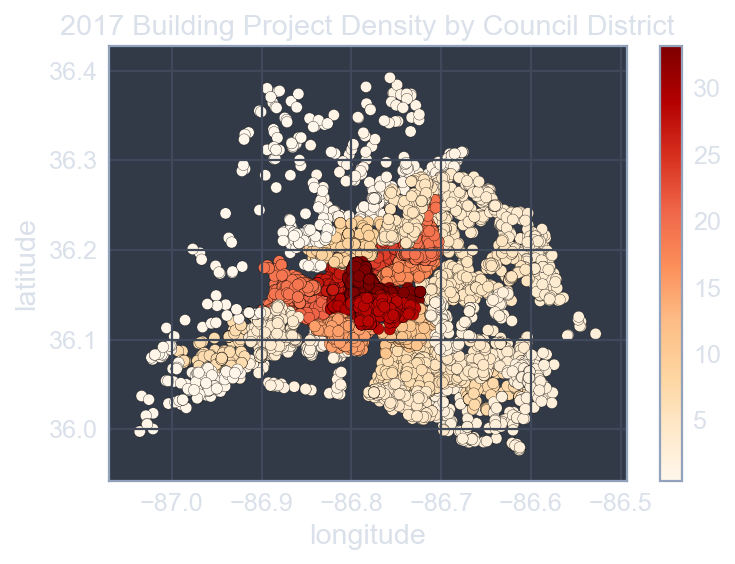

In [111]:
districts_and_permits = pd.merge(permits_by_district, counts_df, on = 'district')

districts_and_permits['permit_density'] = districts_and_permits.apply(
    lambda row: row.bldg_permits / row.area, axis = 1)
print(districts_and_permits.head(2))

districts_and_permits.plot(column = 'permit_density', cmap = 'OrRd',
                           edgecolor = 'black', legend = True)

plt.xlabel('longitude')
plt.ylabel('latitude')
plt.title('2017 Building Project Density by Council District')
plt.show()

## 13. Choropleths with folium

### folium.Map choropleth

```python
# Construct a map object for Nashville
nashville = [36.1636,-86.7823]
m = folium.Map(location=nashville, zoom_start=10)

# Create a choropleth
m.choropleth(...)
```

### Arguments of the folium choropleth

* `geo_data` - the source data for the polygons (geojson file or a GeoDataFrame)
* `name`  - the name of the geometry column (or geojson property) for the polygons
* `data` - the source DataFrame or Series for the normalized data
* `columns` - a list of columns: one that corresponds to the polygons and one that has the value to plot

### Additional arguments of the folium choropleth

* `key_on` - a GeoJSON variable to bind the data to (always starts with `feature`)
* `fill_color` - polygon fill color (defaults to blue)
* `fill_opacity` - range between 0 (transparent) and 1 (completely opaque)
* `line_color` - color of polygon border lines (defaults to black)
* `line_opacity` - range between 0 (transparent) and 1 (completely opaque)
* `legend_name` - creates a title for the legend

### Folium choropleth of school density

```python
# Center point and map for Nashville
nashville = [36.1636,-86.7823]
m = folium.Map(location=nashville, zoom_start=10)
```

```python
# Define a choropleth layer for the map
m.choropleth(geo_data=districts_with_counts,
             name='geometry',
             data=districts_with_counts,
             columns='district','school_density'],
             key_on='feature.properties.district',
             fill_color='YlGn',
             fill_opacity=0.75,
             line_opacity=0.5,
             legend_name='Schools per km squared by School District')
```

```python
# Add layer control and display
folium.LayerControl().add_to(m)
display(m)
```

<img src='Visualizing_Geospatial_Data_in_Python/Pictures/Map.png' alt='Map' width=700 align='left'>

### №37 Folium choropleth

1. Create a map object `m` using the `nashville` point for `location` and a `zoom_start` of 10

In [112]:
nashville = [36.1636,-86.7823]
m = folium.Map(location=nashville, zoom_start=10)

2. 
    * Use `districts_and_permits`: `geometry` for polygons, `district` & `permit_density` to color. Use Reds and `0.5` opacity for the fill; Set `line_opacity` to `1.0`
    * Set `key_on` to `feature.properties.district`. Use the title provided

In [113]:
m.choropleth(
    geo_data=districts_and_permits,
    name='geometry',
    data=districts_and_permits,
    columns=['district', 'permit_density'],
    key_on='feature.properties.district',
    fill_color='Reds',
    fill_opacity=0.5,
    line_opacity=1.0,
    legend_name='2017 Permitted Building Projects per km squared'
)

3. Next create and add a `folium` `LayerControl()`. Display the map

In [114]:
folium.LayerControl().add_to(m)
display(m)   

### №38 Folium choropleth with markers and popups

* Find the centroid for each council district and store it in a new column, `center` in the `districts_and_permits` GeoDataFrame
* Iterate through `districts_and_permits` and add a marker at each district's `center`. Remember to reverse the coordinate pair
* Create `popups` within your `for` loop to display the district number and the count of permits issued
* Add the markers to your map with `.add_to()` and display it

In [115]:
districts_and_permits.head()

,permit_id,issued,cost,lat,lng,geometry,index_right,first_name,email,res_phone,bus_phone,last_name,position,district,area,bldg_permits,permit_density
0,2017032777,2017-05-24,226201.0,36.198241,-86.742235,POINT (-86.74223499999999 36.198241),5,Scott,scott.davis@nashville.gov,615-554-9730,615-862-6780,Davis,Council Member,5,19.030612,452,23.751207
1,2017053890,2017-09-05,0.0,36.185442,-86.768239,POINT (-86.76823900000001 36.185442),5,Scott,scott.davis@nashville.gov,615-554-9730,615-862-6780,Davis,Council Member,5,19.030612,452,23.751207
2,2017047073,2017-08-22,165708.0,36.203964,-86.741792,POINT (-86.741792 36.203964),5,Scott,scott.davis@nashville.gov,615-554-9730,615-862-6780,Davis,Council Member,5,19.030612,452,23.751207
3,2016064424,2017-01-11,10000.0,36.196708,-86.774026,POINT (-86.77402600000001 36.196708),5,Scott,scott.davis@nashville.gov,615-554-9730,615-862-6780,Davis,Council Member,5,19.030612,452,23.751207
4,2017069196,2017-10-26,80000.0,36.199428,-86.766651,POINT (-86.766651 36.199428),5,Scott,scott.davis@nashville.gov,615-554-9730,615-862-6780,Davis,Council Member,5,19.030612,452,23.751207


In [116]:
districts_and_permits['center'] = districts_and_permits.geometry.centroid

for row in districts_and_permits.iterrows():
    row_values = row[1] 
    center_point = row_values['center']
    location = [center_point.y, center_point.x]
    popup = ('Council District: ' + str(row_values['district']) + 
             ';  ' + 'permits issued: ' + str(row_values['bldg_permits']))
    marker = folium.Marker(location = location, popup = popup)
    marker.add_to(m)
    
display(m)